# Material property targets for emergingn nanomaterials to enable point-of-use and point-of-entry water treatment systems
Elvis A. Eugene, William A. Phillip, Alexander W. Dowling

Department of Chemical and Biomolecular Engineering

University of Notre Dame, Notre Dame, IN 46556

In [1]:
# load libraries and set plot parameters

import matplotlib.pyplot as plt
import numpy as np
from pandas import read_csv
import matplotlib.ticker
from matplotlib import cm # custom color map
import sys # terminate with error message
import itertools


# plot parameters
SMALL_SIZE = 12
MEDIUM_SIZE = 28
BIGGER_SIZE = 32
NEW_PAD = 12

# plt.rc('font', size=SMALL_SIZE)          # controls default text sizes
# plt.rc('axes', titlesize=SMALL_SIZE)     # fontsize of the axes title
# plt.rc('axes', labelsize=SMALL_SIZE)    # fontsize of the x and y labels
# plt.rc('xtick', labelsize=BIGGER_SIZE)    # fontsize of the tick labels
# plt.rc('ytick', labelsize=BIGGER_SIZE)    # fontsize of the tick labels
# plt.rc('legend', fontsize=SMALL_SIZE)    # legend fontsize
# plt.rc('figure', titlesize=BIGGER_SIZE)  # fontsize of the figure title
# plt.rc('axes', titlesize=SMALL_SIZE)    # fonstize for axis title
# plt.rc('axes', titlepad=NEW_PAD)         # increase spacing between axis title and plot while using BIGGER_SIZE title 

## Functions

### Auxiliary functions

#### Square log-log plots

In [2]:
# https://stackoverflow.com/questions/27579898/how-to-create-square-log-log-plots-in-matplotlib
def set_aspect_ratio_log(plot, aspect_ratio):
        x_min, x_max = plot.get_xlim()
        y_min, y_max = plot.get_ylim()
        return plot.set_aspect(aspect_ratio * ((np.log10(x_max / x_min)) / (np.log10(y_max / y_min))))

#### Square plots

In [3]:
# modified from https://stackoverflow.com/questions/27579898/how-to-create-square-log-log-plots-in-matplotlib
def set_aspect_ratio(plot, aspect_ratio):
        x_min, x_max = plot.get_xlim()
        y_min, y_max = plot.get_ylim()
        return plot.set_aspect(aspect_ratio * ((abs(x_max - x_min)) / (abs(y_max - y_min))))

#### Row-first multicolumn legend

In [4]:
# https://stackoverflow.com/questions/10101141/matplotlib-legend-add-items-across-columns-instead-of-down
def flip(items, ncol):
    return itertools.chain(*[items[i::ncol] for i in range(ncol)])

### Make material property target plots with dimensions

In [5]:
def make_material_property_plots(dname):
    '''
    inputs:
    dname - directory in which case study data is saved
    
    outputs - 
    material property target curve for semi-continuous process with dimensions saved into same path as dname
    ''' 
    ## read data for semicontinuous mpt curves

    # masses over which mpt curves were generated
    mpt_masses = np.genfromtxt(dname+'/sbmpt_mspan.csv',delimiter=',').astype(int);

    # span of K for the mpt curves
    mpt_Ks = np.genfromtxt(dname+'/batmpt_Kspan.csv',delimiter=',');

    # empty array to store Q values
    mpt_Qs = np.empty_like(mpt_Ks);

    # read all the Q data for the mpt curves
    for i, mass in enumerate(mpt_masses):
        if i == 0:
            mpt_Qs = np.genfromtxt(dname+'/sbmpt_Q_'+str(mass)+'.csv',delimiter=',');
        else:
            temp = np.genfromtxt(dname+'/sbmpt_Q_'+str(mass)+'.csv',delimiter=',');
            mpt_Qs = np.vstack((mpt_Qs,temp));

    # read sorbent property data from a .csv file
    sorbent_dat = read_csv('sorbent_prop.csv',sep=',').values.tolist()

    # extract data to meaningful variable names
    sorbents = [];
    sorb_Qs = [];
    sorb_Ks = [];
    sorb_refs = [];

    # Placeholder for sorbents in legend
    ph = list(map(chr, range(65,90)))

    for i in range(len(sorbent_dat)):
        sorbents.append(sorbent_dat[i][0]);
        sorb_Qs.append(sorbent_dat[i][1]);
        sorb_Ks.append(sorbent_dat[i][2]);
        sorb_refs.append(sorbent_dat[i][3]);

    # read feasible limits of Q at 65 psi (this was required for the old code 
    # in which the mpt curves had a different linestyle above and below the feasible 
    # limit of Q) I'm leaving this functionality in here in case it becomes useful in 
    # the future. If this is going to be used, please ensure that the MATLAB script 
    # generating Q_feaslim data is up to date
    Q_feaslim = np.genfromtxt(dname+'/Q_feaslim.csv',delimiter=',');

    # read data for upper bound curve
    del_P_vec = np.genfromtxt(dname+'/del_P_vec.csv',delimiter=',',dtype=int);

    # read capacity upper bound data generated by optimization
    # by the time the optimization problem was written, it became clear that maximum
    # capacity curves generated at different pressures were overlapping
    # hence, the optimization problem is written only for the average household
    # pressure of 65 psig and there is no need to loop over pressures to read data
    OPTQs = np.genfromtxt(dname+'/max_cap_curve/sp_thr_1e-04/pyo_cap_ub_Qs.csv',delimiter=',');
    OPTKs = np.genfromtxt(dname+'/max_cap_curve/sp_thr_1e-04/pyo_cap_ub_Ks.csv',delimiter=',');
    OPTQs_1mm = np.genfromtxt(dname+'/max_cap_curve/sp_thr_1e-03/pyo_cap_ub_Qs.csv',delimiter=',');
    OPTKs_1mm = np.genfromtxt(dname+'/max_cap_curve/sp_thr_1e-03/pyo_cap_ub_Ks.csv',delimiter=',');
    
    ## plot mpt curves
    
    # set figure sizing parameters
    w_in = 3. # width in inches
    h_in = 4.0 # height in inches
    dpi_fig = 1200 # pixel density in dots per inch
    
    fig15, ax15 = plt.subplots(figsize=(w_in,h_in),dpi=dpi_fig,edgecolor='b',linewidth=2);
    
    # this convoluted block within the for loop allows plotting the feasible 
    # and infeasible regions of the mpt curves in different linestyles, if required.
    # try setting two different linestyles in each of the plot commands to see this.
    for i, mass in enumerate(mpt_masses):
        # semi-batch process - feasible region
        line = plt.loglog(mpt_Ks[np.nonzero((mpt_Qs[i,:]<=1e3))], mpt_Qs[i,mpt_Qs[i,:]<=1e3],'-',linewidth=1)
        # semi-batch process - feasible region ()
#         plt.loglog(mpt_Ks[np.nonzero((mpt_Qs[i,:]>1e3))], mpt_Qs[i,mpt_Qs[i,:]>1e3],'w-');
        # ghost line for nice legend
        plt.loglog([],[],color=line[0].get_color(),label="{0} kg".format(mass));

        # dotted interconnecting line between the two linestyles used in the plotting loop
        if not (mpt_Ks[np.nonzero((mpt_Qs[i,:]<=Q_feaslim[i]))].size==0):
            x1 = mpt_Ks[np.nonzero((mpt_Qs[i,:]>Q_feaslim[i]))][-1]; 
            y1 = mpt_Qs[i,mpt_Qs[i,:]>Q_feaslim[i]][-1];
            x2 = mpt_Ks[np.nonzero((mpt_Qs[i,:]<=Q_feaslim[i]))][0];
            y2 = mpt_Qs[i,mpt_Qs[i,:]<=Q_feaslim[i]][0];
            plt.loglog([x1,x2],[y1,y2],'--',color=line[0].get_color());
        # END: dotted interconnecting line between the two linestyles used in the plotting loop
    # END: plotting loop over mpt_masses 

    # plot sorbent data on MPT plot
    for i in range(len(sorb_Ks)):
        # letters of the alphabet as markers
#         plt.loglog(sorb_Ks[i],sorb_Qs[i],"k",marker="${0}$".format(ph[i]),markersize=14,)

        # regular markers
        plt.loglog(sorb_Ks[i],sorb_Qs[i],"kx",markersize=3)
    # END: plot sorbent data on MPT plot

    # loop over pressures and add ub lines to plot
    for i, del_P in enumerate(del_P_vec):

        # note that logical statement i.e. ... (..) & (..) ... ensures that the ub lines are 
        # plotted within the same range used for mpt_Ks ensuring cleaner plots
        if i == 1:
            plt.loglog(OPTKs, OPTQs,"k--",linewidth=1,label="$Q_{UB1}$")
            plt.loglog(OPTKs_1mm, OPTQs_1mm,"k",ls=(0,(1,2)),markevery=10,label="$Q_{UB2}$")

#             plt.loglog(OPTKs_1mm, OPTQs_1mm,"k",ls='none',marker = 'x',\
#                        markevery=30,markersize=2,markerfacecolor='none',markeredgecolor='k',label="$Q_{UB2}$")
        # END: plots only for 65 psi
    # END: loop over pressures and add ub lines to plot
    
    ## make plots pretty
    
    # Axis ticks
    ax15.set_yticks([1e-2,1e-1,1e0,1e1,1e2,1e3])
    ax15.set_xticks([1e-2,1e0,1e2,1e4,1e6,1e8])
    ax15.tick_params(labelsize=12)
    ax15.set_xlim(5*1e-3,1e9)
    ax15.set_ylim(5*1e-3,5*1e3)
    
    # axes labels
    plt.xlabel('K (M$\mathbf{{}^{-1}}$) \n-\n-\n-',in_layout=True,fontsize=16,fontweight='bold');
    plt.ylabel(r'Q (mmol g$\mathbf{{}^{-1}}$)',in_layout=True,fontsize=16,fontweight='bold');
    
    # squeeze bounding box around figure
    fig15.tight_layout()
    
    # legend
    plt.legend(loc='upper center',borderaxespad=0.,ncol=3,fontsize=10,\
               bbox_to_anchor=(0.37,-0.33),\
               handletextpad=0.5,columnspacing=0.5,\
               framealpha=1.0);
    # grid
    plt.grid(True);
    
    # square aspect ratio of axes
    # https://stackoverflow.com/questions/27579898/how-to-create-square-log-log-plots-in-matplotlib
    set_aspect_ratio_log(ax15, 1.0)
    
    # turn off minor ticks
    # https://stackoverflow.com/questions/10781077/how-to-disable-the-minor-ticks-of-log-plot-in-matplotlib
    plt.minorticks_off()
    
    # save
    plt.savefig(dname+'/mpt_feas_qub.png',bbox_inches='tight',dpi=dpi_fig);
    plt.savefig(dname+'/mpt_feas_qub.pdf',bbox_inches='tight',dpi=dpi_fig);
    plt.savefig(dname+'/mpt_feas_qub.eps',bbox_inches='tight',dpi=dpi_fig);
    
    # display figure
    plt.show();

### Make material property target plots without dimensions

In [6]:
# define a function to plot non-dimensional material property target curves
def make_ndmpt_plots(N_BV_span,eps,rec,mpt_Knd, nondim_type):
    '''
    inputs:
    N_BV_span - range of N_BV i.e. bed volumes to plot
    eps - porosity 
    rec - removal ratio
    mpt_Knd - range of Ks to plot
    nondim_type - flag to indicate which type of plot is being printed,\
                    based on which plot parameters will be set
    
    outputs - 
    material property target curve without dimensions saved into the case4 folder
    ''' 
    
    dname = 'case4'
    
    colors = ['#1f77b4', '#ff7f0e', '#8c564b', '#e377c2']
    
    ## read data for dimensionless curves   
    
    # read first set of data for dimensionless Q for the semibatch process
    sb_mpt_Qnd = np.genfromtxt('{0}/Q_nd_semi_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV_span[0]),\
                               delimiter=',');
#     sb_mpt_Qnd = np.genfromtxt(dname+'/Q_nd_semi_eps'+str(eps)+'_r'+str(rec)+'nbv_'+str(N_BV_span[0])+'.csv',delimiter=',');
    
    # read first set of data for dimensionless Q for the batch process
    bat_mpt_Qnd = np.genfromtxt('{0}/Q_nd_bat_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV_span[0]),\
                                delimiter=',');
    
    # read first data point for crossover point
    crossover_dat = np.genfromtxt('{0}/crossover_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV_span[0]),\
                                  delimiter=',');
     
    # read all the K and Q data for the mpt curves
    for i, N_BV in enumerate(N_BV_span):
        if i > 0: # read from second data point onwards
            temp2 = np.genfromtxt('{0}/Q_nd_semi_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV),\
                                  delimiter=',');
            sb_mpt_Qnd = np.vstack((sb_mpt_Qnd,temp2));
            
            temp3 = np.genfromtxt('{0}/Q_nd_bat_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV),\
                                  delimiter=',');
            bat_mpt_Qnd = np.vstack((bat_mpt_Qnd,temp3));  
            
            temp4 = np.genfromtxt('{0}/crossover_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV),\
                                  delimiter=',');
            crossover_dat = np.vstack((crossover_dat,temp4));
        # END: read from second data point onwards
    # END: read all the K and Q data for the mpt curves
    
    # set figure sizing parameters
    w_in = 3. # width in inches
    h_in = 3.0 # height in inches
    dpi_fig = 1200 # pixel density in dots per inch
    
    # plot
    fig13, ax13 = plt.subplots(figsize=(w_in,h_in),dpi=dpi_fig,edgecolor='b',linewidth=2);
    
    # loop over bed volumes i.e. N_BV_span and plot material property target curves
    for i, N_BV in enumerate(N_BV_span):
                    
        # semi-continuous process
        line = plt.loglog(mpt_Knd, sb_mpt_Qnd[i,:],label="$N_{BV}$ = "+str(int(N_BV)),\
                          linewidth=1,color=colors[i])

        # batch process
        plt.loglog(mpt_Knd, bat_mpt_Qnd[i,:],"--",color=line[0].get_color(),\
                  linewidth=1)

        # crossover point
        plt.loglog(crossover_dat[i,0],crossover_dat[i,1],marker="o",\
                   markeredgecolor=line[0].get_color(),markerfacecolor="none",markersize=5);
    # END: loop over bed volumes i.e. N_BV_span and plot material property target curves
        
    ## print sorbent data
    
    # empty list to store sorbent data
    sorb_Qs = [];
    sorb_Ks = [];
      
    # annotate arsenic case study plots with exsiting sorbent properties
    if nondim_type=='arsenic':
        
        # read sorbent property data from a .csv file
        sorbent_dat = read_csv('case4/arsenic_adsorbents_dimensionless.csv',\
                               sep=',',header=None).values.tolist()
        
        # loop over number of sorbents and save associated data into meaningful variables
        for i in range(len(sorbent_dat)):
            sorb_Ks.append(sorbent_dat[i][2]);
            sorb_Qs.append(sorbent_dat[i][3]);
        # END: loop over number of sorbents and save associated data into meaningful variables
        
        # loop over number of sorbents and add data points to plot
        for i in range(len(sorb_Ks)):
            print('i=',i,'k=',sorb_Ks[i],'q=',sorb_Qs[i])
            plt.loglog(sorb_Ks[i],sorb_Qs[i],"kx",markersize=3)
        # END: loop over number of sorbents and add data points to plot
                    
    ## Make plots pretty
    
    # Ghost points for legend
    plt.plot([],[],'k--',label='Batch')
    plt.plot([],[],'k-',label='Semi-\ncontinuous')
    
    # Axis labels
    plt.xlabel(r'$\mathbf{\bar{K}}$',in_layout=True,fontsize=16,fontweight='bold');
    plt.ylabel(r'$\mathbf{\bar{Q}}$',in_layout=True,fontsize=16,fontweight='bold');
    
    # plot title (unused)
    # plt_title = r'Dimensionless MPT (r={0}, $\epsilon$={1})'.format(rec,eps);
    
    # filename
    fname = dname+'/nd_mpt_r{0}_eps{1}.png'.format(rec,eps); 
    
    
    # since multiple plots are printed using this function,\
    # some plot parameters are defined based on the type of 
    # plot being printed
    if nondim_type == 'type3': # type 3 behavior plots
        
        ax13.set_yticks([1e0,1e2,1e4,1e6,1e8]) # y-ticks
        ax13.set_ylim(5*1e-1,5*1e8) # y-lim
        
    elif nondim_type == 'arsenic': # arsenic case study plots
    
        ax13.set_yticks([1e2,1e4,1e6,1e8,1e10]) # y-ticks
        ax13.set_ylim(5*1e1,5*1e10) # y-lim
        plt.plot([],[],'ko',markersize=5,markerfacecolor='none',label='Crossover')
        
    elif nondim_type == 'type1': # type1 and type 2 are very similar  
        
        ax13.set_yticks([1e0,1e2,1e4,1e6,1e8,1e10]) # y-ticks
        ax13.set_ylim(5*1e-1,5*1e10) # y-lim
    
    elif nondim_type == 'type2':
    
        ax13.set_yticks([1e0,1e2,1e4,1e6,1e8,1e10]) # y-ticks
        ax13.set_ylim(5*1e-1,5*1e10) # y-lim
        plt.plot([],[],'ko',markersize=5,markerfacecolor='none',label='Crossover')
    # END: set some parameters specific to plot type
    
    # set common parameters
    ax13.set_xticks([1e-4,1e-2,1e0,1e2,1e4]) # x-ticks
    ax13.set_xlim(5*1e-5,5*1e4) # x-lim
    ax13.tick_params(labelsize=12) # ticksize
    plt.minorticks_off(); # turn off minor ticks

    # print legend row-first
    # set number of columns in the legend
    ncol = 3 
    # get handles and labels of the legend to flip
    handles, labels = ax13.get_legend_handles_labels()
   
    # legend
    plt.legend(flip(handles,ncol),flip(labels,ncol),\
               loc='upper center',ncol=ncol,fontsize=10,borderaxespad=0.,\
               handletextpad=0.5,columnspacing=0.5,\
               bbox_to_anchor = (0.35,-0.22),
               labelspacing=0.2,handlelength=1)
    
    # square aspect ratio of axes
    # https://stackoverflow.com/questions/27579898/how-to-create-square-log-log-plots-in-matplotlib
    set_aspect_ratio_log(ax13, 1.0)
    
    # legend
#     plt.legend(loc='upper center',borderaxespad=0.,ncol=3,fontsize=10,\
#                bbox_to_anchor=(0.37,-0.33),\
#                handletextpad=0.5,columnspacing=0.5,\
#                framealpha=1.0);
    
    # grid
    plt.grid(True);
    
    # save 
    plt.savefig(fname,bbox_inches='tight',dpi=dpi_fig)
    
    # display on screen
    plt.show();
    
# END: define a function to plot non-dimensional material property target curves

## Breakthrough time schematic

In [7]:
def make_breakthrough_schema(dname):
    '''
    inputs:
    dname - directory in which case study data is saved
    
    outputs - 
    schematic of the breakthrough time curve which is used in 
    the process configurations figure
    '''     
    
    ## read data for semibatch adsorption breakthrough curves
    
    # integration timesteps
    T_dat1 = np.genfromtxt(dname+'/semibatch_op_T_pash.csv',delimiter=',')
    # concentration in finite elements
    C_dat1 = np.genfromtxt(dname+'/semibatch_op_C_pash.csv',delimiter=',')
    # finite element lengths
    length_span_dat1 = np.genfromtxt(dname+'/semibatch_op_lengths_pash.csv',delimiter=',')

    # terp
    # integration timesteps
    T_dat2 = np.genfromtxt(dname+'/semibatch_op_T_terp.csv',delimiter=',')
    # concentration in finite elements
    C_dat2 = np.genfromtxt(dname+'/semibatch_op_C_terp.csv',delimiter=',')
    # finite element lengths
    length_span_dat2 = np.genfromtxt(dname+'/semibatch_op_lengths_terp.csv',delimiter=',')
    
    ## Convert data into 'nice' units

    # PASH
    # T from seconds to days
    T1 = T_dat1 / (3600*24);
    # lengths from meters to microns
    L1 = length_span_dat1 * 1e6;
    # concentrations from mmol / cm3 to ppb
    C1 = C_dat1 * (207.2)/(1/1e3)

    # terp
    # T from seconds to days
    T2 = T_dat2 / (3600*24);
    # lengths from meters to microns
    L2 = length_span_dat2 * 1e6;
    # concentrations from mmol / cm3 to ppb
    C2 = C_dat2 * (207.2)/(1/1e3)

    ## plot breakthrough curves
    fig, ax = plt.subplots(figsize=(3,3));

    # terp
    CS2 = ax.contour(T2,L2,C2.T,[100],colors='black');

    ## ghost points for legend
    # pash
    p1 = ax.plot(0,0,'k')
    # terp
    p2 = ax.plot(0,0,'k--')

    h1, l1 = CS2.legend_elements();
    ax.legend(p1,['Treated water concentration'],\
              loc='upper center',bbox_to_anchor=(0,-0.3,1.0,0.102),mode='expand',borderaxespad=0.,ncol=1);
    plt.grid(True);
    plt.ylim(0,1.1*max(np.amax(L1),np.amax(L2)));
    plt.xlim(0,1000)
    plt.xlabel('Time');
    plt.ylabel(r'Adsorption Front');
    # Turn off tick labels
    ax.set_yticklabels([])
    ax.set_xticklabels([])
    # plt.title('Breakthrough Curves \n(50 kg membrane module)');
    plt.savefig(dname+'/breakthrough_scheme.png',bbox_inches='tight',dpi=300);
    plt.show();

### Breakthrough time schematic

Schematic is used in the process configurations figure of the main paper. Data required for this plot may be obtained by running case 6 in the MATLAB script run_adsorption_analysis.m

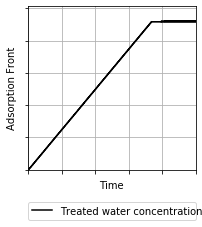

In [8]:
make_breakthrough_schema('case6');

### Point of use application 1: Regenerate once in two years

The data for this plot is obtained by running Case 1 from MATLAB script run_adsorption_analysis.m

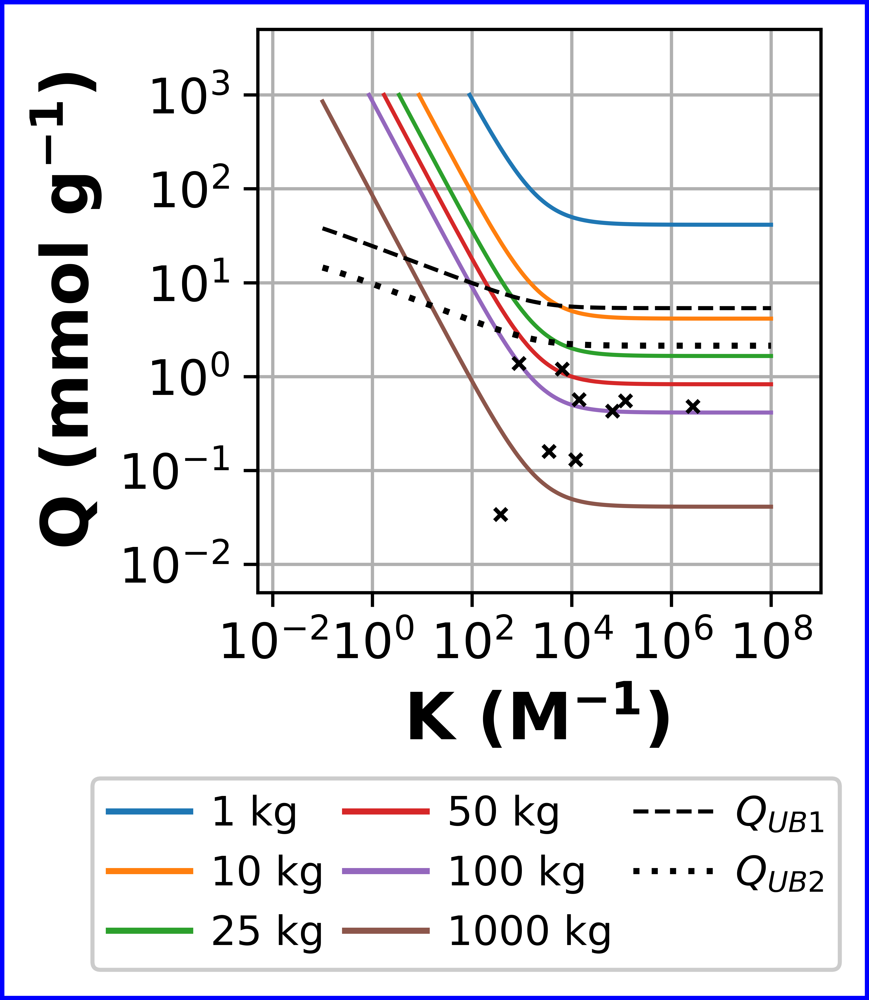

In [9]:
make_material_property_plots('case1')

### Point of use application 2: Regenerate once in six months

The data for this plot is obtained by running Case 2 from MATLAB script run_adsorption_analysis.m

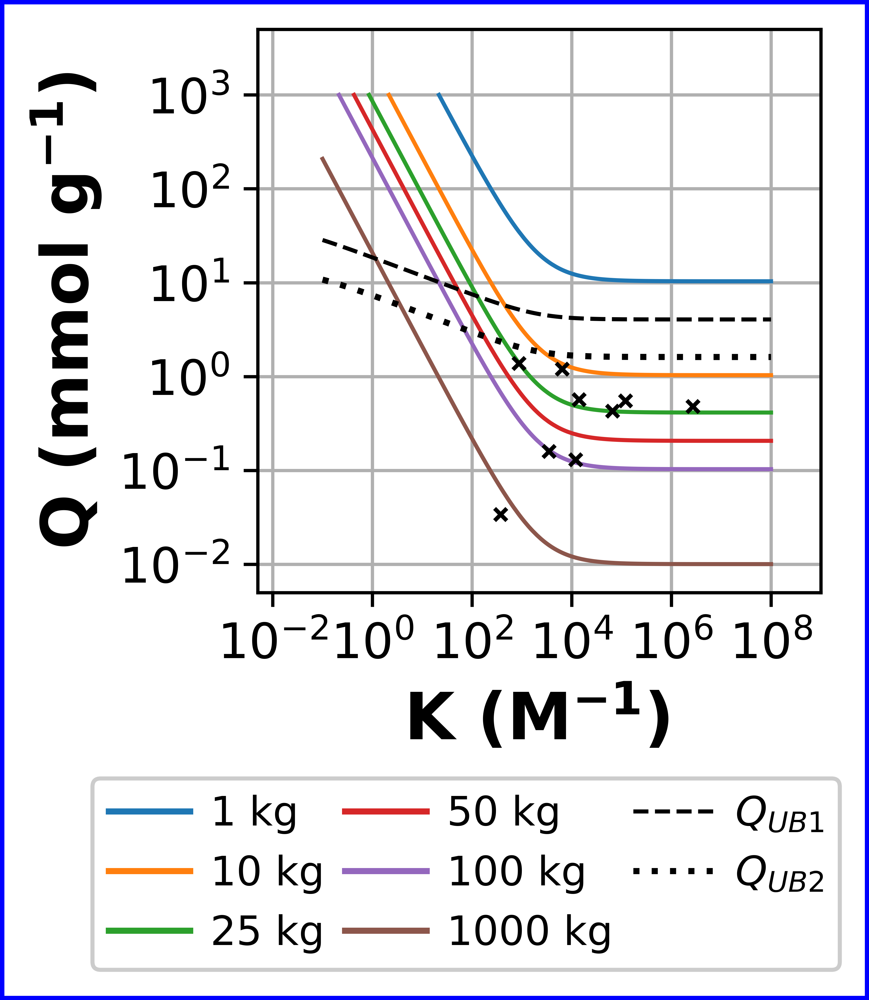

In [10]:
make_material_property_plots('case2')

## Dimensionless material property curves

### Competitive behavior between batch and semi-continuous process configurations

### Arsenic removal case study (generic adsorption process)

The data required for these plots is obtained by running Case 4 from MATLAB script run_adsorption_analysis.m

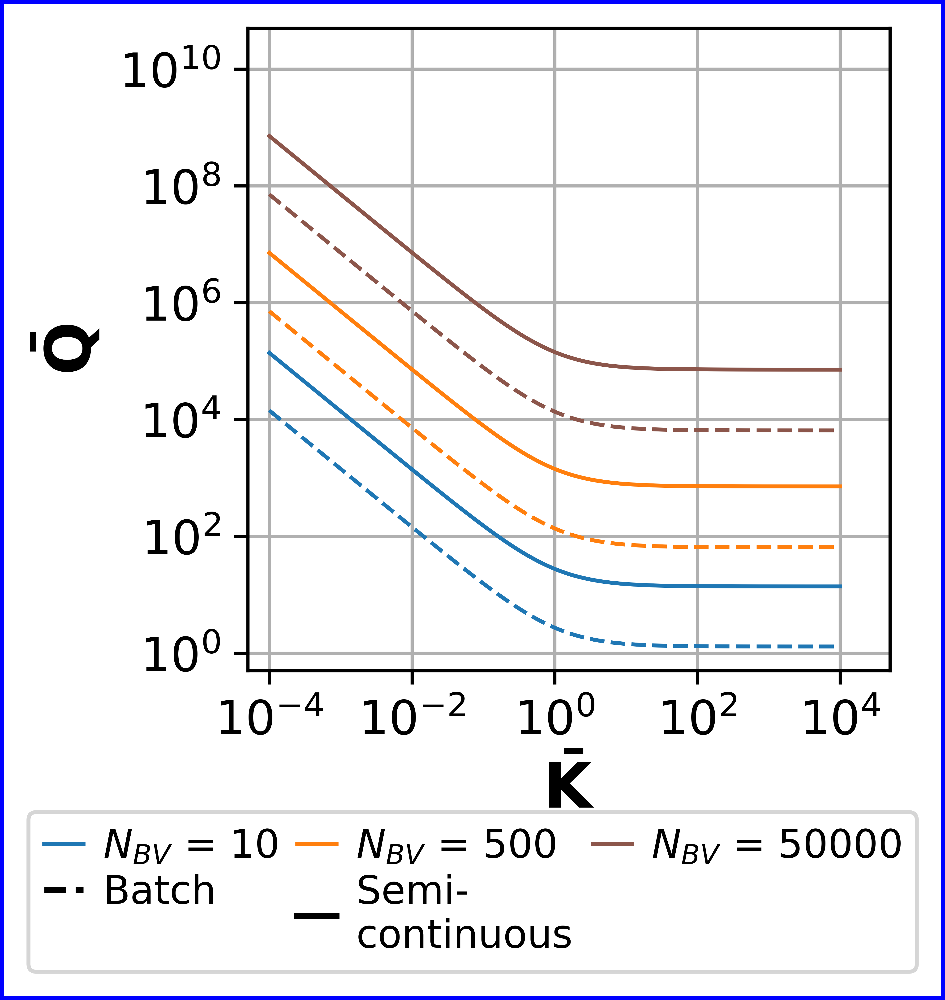

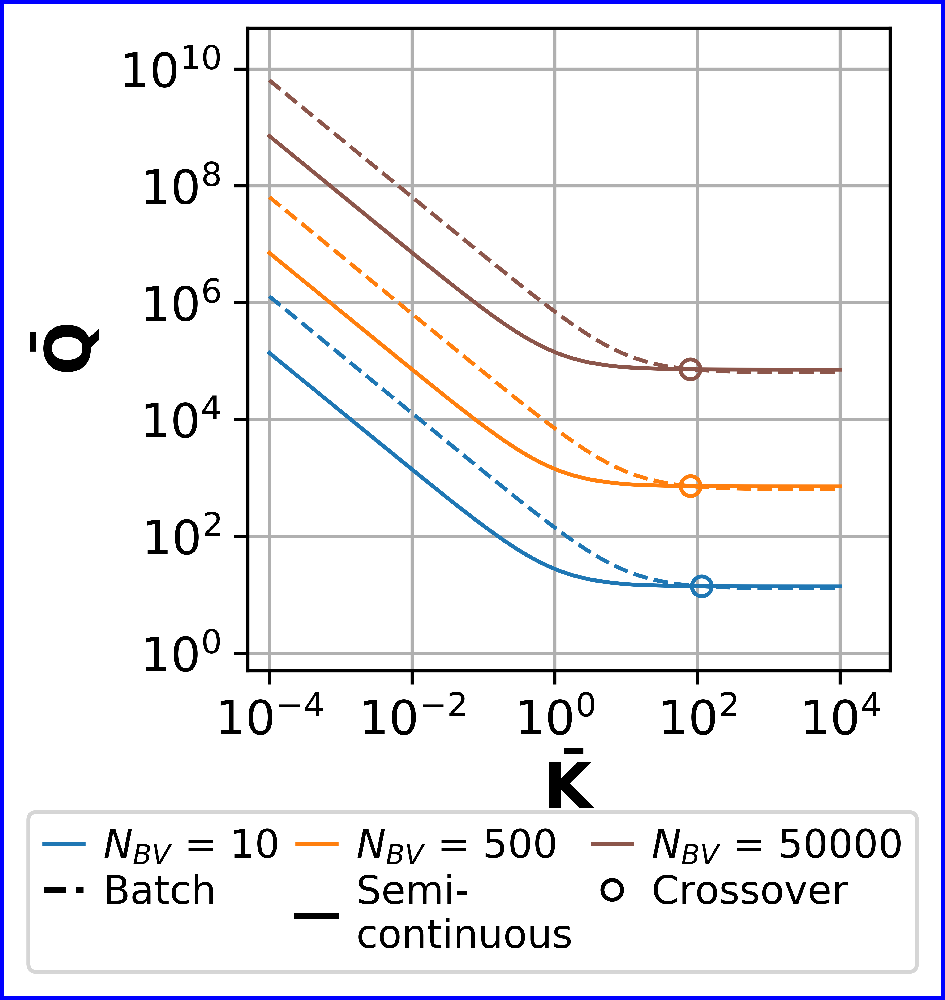

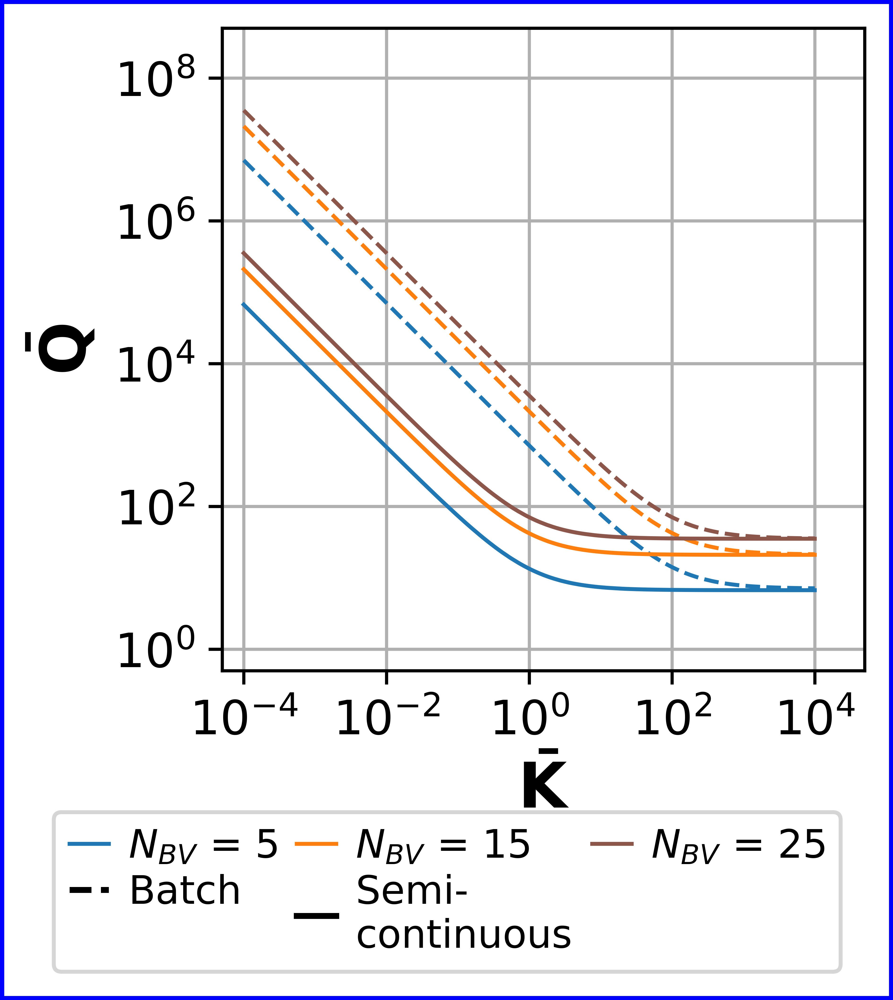

i= 0 k= 0.001526 q= 174000.0
i= 1 k= 0.006762000000000001 q= 248000.0
i= 2 k= 0.77 q= 6500.0
i= 3 k= 5.6 q= 5450.0


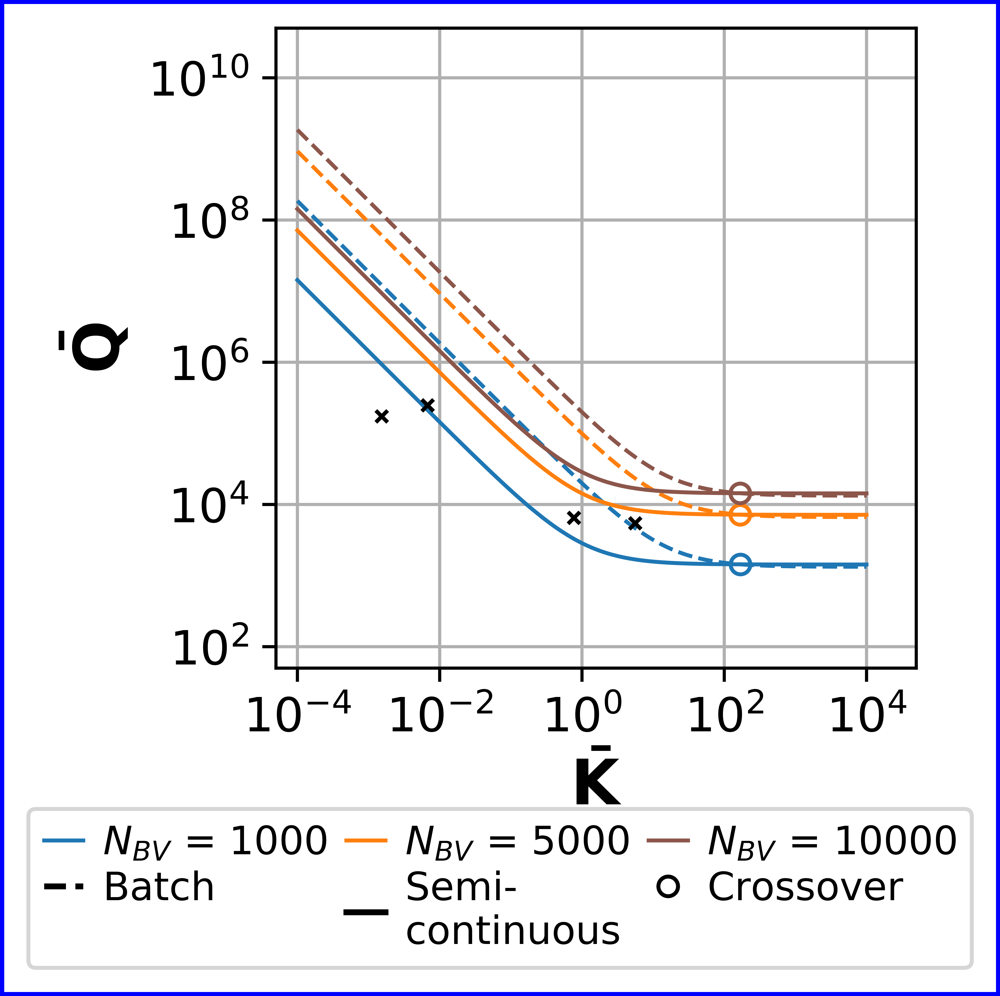

In [11]:
N_BV_span_all = np.genfromtxt('case4/N_BV_span_all.csv',delimiter=',');
eps_span = np.genfromtxt('case4/eps_span.csv',delimiter=',');
rec_span = np.genfromtxt('case4/rec_span.csv',delimiter=',');
mpt_Knd = np.genfromtxt('case4/sbmpt_Knondim.csv',delimiter=',');

# flag to print existing materials on dimensionless plots
print_existing = False

# flags for type of plot being printed
# note that the length of nondim_type should be equal to the length of 
# N_BV_span_all, etc.
nondim_type = ['type1','type2','type3','arsenic']

# loop over parameters and make plots
for i, rec in enumerate(rec_span):  
    N_BV_span = N_BV_span_all[i,:]
    make_ndmpt_plots(N_BV_span,eps_span[i],rec,mpt_Knd,nondim_type[i])
# end loop over eps_span

# Supporting Information

### Make derivation schematics

In [12]:
# define a function to plot non-dimensional material property target curves
def make_deriv_schema(N_BV_span,eps,rec,mpt_Knd, behav_type):
    '''
    inputs:
    N_BV_span - range of N_BV i.e. bed volumes to plot
    eps - porosity 
    rec - removal ratio
    mpt_Knd - range of Ks to plot
    behav_type - flag to indicate which type of plot is being printed,\
                    based on which plot parameters will be set or 
                    manipulated (since type 4 behavior is not 
                    physically observable, we obtain schematics for 
                    this behavior by manipulating plots from another type
                    of behavior )
    
    outputs - 
    material property target curve without dimensions saved into the case6 folder
    ''' 
    
    dname = 'case6'
    
    ## read data for dimensionless curves   
    
    # read first set of data for dimensionless Q for the semibatch process
    sb_mpt_Qnd = np.genfromtxt('{0}/Q_nd_semi_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV_span[0]),\
                               delimiter=',');
    # read first set of data for dimensionless Q for the batch process
    bat_mpt_Qnd = np.genfromtxt('{0}/Q_nd_bat_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV_span[0]),\
                                delimiter=','); 
    # read first data point for crossover point
    crossover_dat = np.genfromtxt('{0}/crossover_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV_span[0]),\
                                  delimiter=',');
     
    # read all the K and Q data for the mpt curves
    for i, N_BV in enumerate(N_BV_span):
        if i > 0: # read from second data set onwards
            temp2 = np.genfromtxt('{0}/Q_nd_semi_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV),\
                                  delimiter=',');
            sb_mpt_Qnd = np.vstack((sb_mpt_Qnd,temp2));
            
            temp3 = np.genfromtxt('{0}/Q_nd_bat_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV),\
                                  delimiter=',');
            bat_mpt_Qnd = np.vstack((bat_mpt_Qnd,temp3));  
            
            temp4 = np.genfromtxt('{0}/crossover_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV),\
                                  delimiter=',');
            crossover_dat = np.vstack((crossover_dat,temp4));
        # END: read from second data set onwards
    # END: read all the K and Q data for the mpt curves
                
    ## plot
    
    # set figure sizing parameters
    w_in = 3. # width in inches
    h_in = 3.0 # height in inches
    dpi_fig = 1200 # pixel density in dots per inch
    
    # instantiate plot object
    fig13, ax13 = plt.subplots(figsize=(w_in,h_in),dpi=dpi_fig);
    
    # loop over bed volumes i.e. N_BV_span and plot material property target curves
    for i, N_BV in enumerate(N_BV_span):
        
        # Plot only one set of curves for schematic
        if i == 1 and not behav_type == 3:

            # semi-continuous process
            line = plt.loglog(mpt_Knd, sb_mpt_Qnd[i,:],\
                              linewidth=1,label="$N_{BV}$ = "+str(int(N_BV)),color='k')

            # batch process
            plt.loglog(mpt_Knd, bat_mpt_Qnd[i,:],"--",\
                       linewidth=1,color=line[0].get_color())

            # crossover point
            plt.loglog(crossover_dat[i,0],crossover_dat[i,1],marker="o",\
                       markeredgecolor=line[0].get_color(),markerfacecolor="none",markersize=5);
            # END: Plot only one set of curves for schematic
        
        elif i == 1 and behav_type == 3:
            # Type 4 behavior cannot be physically observed, and the schematic is produced by manipulating 
            # (switching labels of) the curves exhibiting type 2 behavior
            line = plt.loglog(mpt_Knd, sb_mpt_Qnd[1,:],'--',\
                              linewidth=1,label="$N_{BV}$ = "+str(int(N_BV)),color='k')

            # batch process
            plt.loglog(mpt_Knd, bat_mpt_Qnd[1,:],"-",\
                       linewidth=1,color=line[0].get_color())
            
            # crossover point
            plt.loglog(crossover_dat[i,0],crossover_dat[i,1],marker="o",\
                       markeredgecolor=line[0].get_color(),markerfacecolor="none",markersize=5);
            
            # switch rec to prevent filename overwrite
            rec = str(rec)+'_2'
        # END: plot of type 4 behavior using type 2 plots as basis
    # END: loop over bed volumes i.e. N_BV_span and plot material property target curves
        
    ## make plots pretty
    
    # axis labels
    plt.xlabel(r'$\mathbf{\bar{K}}$',in_layout=True,fontsize=16,fontweight='bold');
    plt.ylabel(r'$\mathbf{\bar{Q}}$',in_layout=True,fontsize=16,fontweight='bold');
    
    # plot title (unused)
    plt_title = r'Dimensionless MPT (r={0}, $\epsilon$={1})'.format(rec,eps);
    
    # turn off minor ticks
    plt.minorticks_off();
    
    # ticks and limits (for uniform gridlines)
    ax13.set_xticks([1e-4,1e-2,1e0,1e2,1e4])
    ax13.set_yticks([1e0,1e2,1e4,1e6,1e8])
    plt.xlim(5*1e-5,5*1e4)
    plt.ylim(5*1e-1,5*1e8)
    
    # turn of ticklabels for schematics
    frame1 = plt.gca()
    frame1.axes.xaxis.set_ticklabels([])
    frame1.axes.yaxis.set_ticklabels([])

    # square aspect ratio
    set_aspect_ratio_log(ax13, 1.0)    
    
    # grid
    plt.grid(True);
    
    ## save and display
    # plot filename
    fname = dname+'/nd_mpt_r{0}_eps{1}_schemtic.png'.format(rec,eps); 
    # save
    plt.savefig(fname,bbox_inches='tight',dpi=dpi_fig)
    # display
    plt.show();
# END: define a function to plot non-dimensional material property target curves

### Make isotherm plots

In [13]:
def make_isotherm_plots(membrane_material):
    '''
    inputs
    membrane material - identify which material the plot is to be made for
    
    outputs
    langmuir isotherm plots for the given material saved to case 6 folder
    '''
    
    # default values
    c_span = np.linspace(0,50,500)
    linestyle = (0, (3, 4, 1, 4))
    # linestyle = (0, (3, 5, 1, 5)) ==> 0 offset, 3 point line,  5 pt space, 1 pt line, 5 pt space
    color = 'k'
    linewidth = 1
    line_label = 'defaults'
    marker = 'o'
    mark_label = 'defaults'
    fname = 'case7/default_isotherm.png'
    x_high = 1.0
    
    # Set parameters based on type of membrane material
    if membrane_material == 'terp':
        c_span = np.linspace(0,0.96,500)
        linestyle = '-'
        color = 'k'
        linewidth = 1 
        line_label = 'Psf-Terp best fit'
        marker = 'v'
        mark_label = 'Psf-Terp experiment'
        fname = 'case7/terp_isotherm.png'
        title = 'Psf-Terp'
        x_high = 1.0
        xticks = [0,0.2,0.4,0.6,0.8,1.0]
    elif membrane_material =='pash':
        c_span = np.linspace(0,40,500);
        linestyle = (0, (3, 4, 1, 4))
        color = 'r'
        linewidth = 1 
        line_label = 'PI-PS-PASH best fit'
        marker = 'o'
        mark_label = 'PI-PS-PASH experiment'
        fname = 'case7/pash_isotherm.png'
        title = 'PI-PS-PASH'
        x_high = 42
        xticks = [0,7,14,21,28,35,42]
    else:
        sys.exit('Unknown membrane material. Function is not defined for this material.')
    # End: Set parameters based on type of membrane material
    
    # Read data
    c_iso = np.genfromtxt('case7/c_iso_'+membrane_material+'.csv',delimiter=',');
    q_iso = np.genfromtxt('case7/q_iso_'+membrane_material+'.csv',delimiter=',');
    Q_fit = np.genfromtxt('case7/Q_fit_'+membrane_material+'.csv', delimiter=',');
    K_fit = np.genfromtxt('case7/K_fit_'+membrane_material+'.csv',delimiter=',');

    # generate isotherm
    q_hat = K_fit * Q_fit * c_span / (1 + K_fit * c_span);
    
    # OLD for reference
#     line = plt.plot(c_span,q_hat_pash,'r',linestyle = (0, (3, 4, 1, 4)), linewidth=2, label="PI-PS-PASH best fit");
#     # linestyle = (0, (3, 5, 1, 5)) ==> 0 offset, 3 point line,  5 pt space, 1 pt line, 5 pt space

#     plt.plot(c_iso_pash, q_iso_pash, 's', markerfacecolor=line[0].get_color(), markeredgecolor = line[0].get_color(),\
#             label="PI-PS-PASH expt.");
#     line = plt.plot(c_span,q_hat_terp,'k',linewidth=2,label="Psf-Terp best fit");
#     plt.plot(c_iso_terp, q_iso_terp, 'v', markerfacecolor=line[0].get_color(), markeredgecolor = line[0].get_color(),\
#             label="Psf-Terp expt.");
    
    # make plots
    
    
    # set figure sizing parameters
    w_in = 3. # width in inches
    h_in = 4.0 # height in inches
    dpi_fig = 1200 # pixel density in dots per inch
    
    # instantiate figure object
    fig15, ax15 = plt.subplots(figsize=(w_in,h_in),dpi=dpi_fig,edgecolor='b',linewidth=2);
    
    # plot best fit line
    line = plt.plot(c_span,q_hat,color=color,linestyle=linestyle,linewidth=linewidth,label=line_label);
    
    # plot experimental data
    plt.plot(c_iso,q_iso,linestyle='none',marker=marker,\
             markerfacecolor=line[0].get_color(),\
             markeredgecolor=line[0].get_color(),\
             markersize = 4,\
             label=mark_label)
    
    ## make plots pretty
    
    # axis labels
    plt.xlabel('Retenate concentration\n(c, mM)',fontsize=16,fontweight='bold');
    plt.ylabel('Bound concentration\n(q, mmol g$\mathbf{{}^{-1}}$)',\
               fontsize=16,fontweight='bold',multialignment='center')
    
    # axis ticks and limits
    yticks = [0,0.25,0.5,0.75,1.00,1.25,1.5]
    ax15.tick_params(labelsize=12)
    ax15.set_xticks(xticks)
    ax15.set_yticks(yticks)  
    plt.xlim(xticks[0],xticks[-1])
    plt.ylim(yticks[0],yticks[-1])
    
    # grid
    plt.grid(True);
    
    # legend
    plt.legend(loc='lower right',ncol=1,borderaxespad = 0.1);
    
    # square aspect ratio
    set_aspect_ratio(ax15,1.0)
    
    # save
    plt.savefig(fname,bbox_inches='tight',dpi=dpi_fig);
    
    # display
    plt.show();

### Make breakthrough time curves

In [14]:
def make_breakthrough_curves(dname):
    '''
    inputs:
    dname - directory in which case study data is saved
    
    outputs - 
    breakthrough time curves saved into the folder specified by dname
    ''' 
    
    ## read data for semibatch adsorption breakthrough curves
    # pash membrane
    # integration timesteps
    T_dat1 = np.genfromtxt(dname+'/semibatch_op_T_pash.csv',delimiter=',')
    # concentration in finite elements
    C_dat1 = np.genfromtxt(dname+'/semibatch_op_C_pash.csv',delimiter=',')
    # finite element lengths
    length_span_dat1 = np.genfromtxt(dname+'/semibatch_op_lengths_pash.csv',delimiter=',')

    # terp membrane
    # integration timesteps
    T_dat2 = np.genfromtxt(dname+'/semibatch_op_T_terp.csv',delimiter=',')
    # concentration in finite elements
    C_dat2 = np.genfromtxt(dname+'/semibatch_op_C_terp.csv',delimiter=',')
    # finite element lengths
    length_span_dat2 = np.genfromtxt(dname+'/semibatch_op_lengths_terp.csv',delimiter=',')
    
    ## Convert data into 'nice' units
    # PASH
    # T from seconds to days
    T1 = T_dat1 / (3600*24);
    # lengths from meters to microns
    L1 = length_span_dat1 * 1e6;
    # concentrations from mmol / cm3 to ppb
    C1 = C_dat1 * (207.2)/(1/1e3)

    # terp
    # T from seconds to days
    T2 = T_dat2 / (3600*24);
    # lengths from meters to microns
    L2 = length_span_dat2 * 1e6;
    # concentrations from mmol / cm3 to ppb
    C2 = C_dat2 * (207.2)/(1/1e3)

    # set figure sizing parameters
    w_in = 3. # width in inches
    h_in = 3.0 # height in inches
    dpi_fig = 1200 # pixel density in dots per inch
    
    # instantiate plot object
    fig, ax = plt.subplots(figsize=(w_in,h_in),dpi=dpi_fig);

    # PASH
    CS1 = ax.contour(T1,L1,C1.T,[100],colors= ['#1f77b4']);

    # terp
    CS2 = ax.contour(T2,L2,C2.T,[100],linestyles='dashed',colors= ['#ff7f0e']);
                                               
    ## make plots pretty
    
    # Axis labels
    plt.xlabel('Time (days)',fontsize=16,fontweight='bold');
    plt.ylabel(str('Adsorption\nfront'+r' ($\mathbf{\mu}$m)'),multialignment='center',\
               fontsize=16,fontweight='bold');
                                            
    # axis limits and ticks
    plt.ylim(0,2500)
    plt.xlim(0,800)
    ax.tick_params(labelsize=12)
    
    # grid
    plt.grid(True);
                              
    # legends are a little trickier for contour plots
    h1, l1 = CS1.legend_elements(); # extract handles and labels
    h2, l2 = CS2.legend_elements();
    # specify labels for handles, and other parameters
    leg = ax.legend(h1+h2,[r'PI-PS-PASH', r'Psf-Terp'], loc='lower right',\
              bbox_to_anchor = (1,0),\
              ncol=1,fontsize=10,title='Concentration\nc=100 ppb',\
                   borderaxespad=0.1);  
    # center the multiline legend title
    plt.setp(leg.get_title(), multialignment='center')
    
    # square aspect ratio 
    set_aspect_ratio(ax,1.0)
    
   # save
    plt.savefig(dname+'/breakthrough.png',bbox_inches='tight',dpi=dpi_fig);
    
    # display
    plt.show();

### Make batch material property target plots

In [15]:
def make_batch_material_property_plots(dname):
    '''
    inputs:
    dname - directory in which case study data is saved
    
    outputs - 
    material property target curve for batch process with dimensions saved into same path as dname
    ''' 
    ## read data for semicontinuous mpt curves

    # masses over which mpt curves were generated
    mpt_masses = np.genfromtxt(dname+'/sbmpt_mspan.csv',delimiter=',').astype(int);

    # span of K for the mpt curves
    mpt_Ks = np.genfromtxt(dname+'/batmpt_Kspan.csv',delimiter=',');

    # empty array to store Q values
    mpt_Qs = np.empty_like(mpt_Ks);

    # read all the Q data for the mpt curves
    for i, mass in enumerate(mpt_masses):
        if i == 0:
            mpt_Qs = np.genfromtxt(dname+'/batmpt_Q_'+str(mass)+'.csv',delimiter=',');
        else:
            temp = np.genfromtxt(dname+'/batmpt_Q_'+str(mass)+'.csv',delimiter=',');
            mpt_Qs = np.vstack((mpt_Qs,temp));

    # read sorbent property data from a .csv file
    sorbent_dat = read_csv('sorbent_prop.csv',sep=',').values.tolist()

    # extract data to meaningful variable names
    sorbents = [];
    sorb_Qs = [];
    sorb_Ks = [];
    sorb_refs = [];

    # Placeholder for sorbents in legend
    ph = list(map(chr, range(65,90)))

    for i in range(len(sorbent_dat)):
        sorbents.append(sorbent_dat[i][0]);
        sorb_Qs.append(sorbent_dat[i][1]);
        sorb_Ks.append(sorbent_dat[i][2]);
        sorb_refs.append(sorbent_dat[i][3]);
    
    ## plot mpt curves
    
    # set figure sizing parameters
    w_in = 3. # width in inches
    h_in = 4.0 # height in inches
    dpi_fig = 1200 # pixel density in dots per inch
    
    fig15, ax15 = plt.subplots(figsize=(w_in,h_in),dpi=dpi_fig,edgecolor='b',linewidth=2);
    
    # this convoluted block within the for loop allows plotting the feasible 
    # and infeasible regions of the mpt curves in different linestyles, if required.
    # try setting two different linestyles in each of the plot commands to see this.
    for i, mass in enumerate(mpt_masses):
        # semi-batch process - feasible region
        line = plt.loglog(mpt_Ks[np.nonzero((mpt_Qs[i,:]<=1e3))], mpt_Qs[i,mpt_Qs[i,:]<=1e3],'-',linewidth=1)
        # semi-batch process - feasible region ()
#         plt.loglog(mpt_Ks[np.nonzero((mpt_Qs[i,:]>1e3))], mpt_Qs[i,mpt_Qs[i,:]>1e3],'w-');
        # ghost line for nice legend
        plt.loglog([],[],color=line[0].get_color(),label="{0} kg".format(mass));

    # END: plotting loop over mpt_masses 

    # plot sorbent data on MPT plot
    for i in range(len(sorb_Ks)):
        # letters of the alphabet as markers
#         plt.loglog(sorb_Ks[i],sorb_Qs[i],"k",marker="${0}$".format(ph[i]),markersize=14,)

        # regular markers
        plt.loglog(sorb_Ks[i],sorb_Qs[i],"kx",markersize=3)
    # END: plot sorbent data on MPT plot

    ## make plots pretty
    
    # Axis ticks
    ax15.set_yticks([1e-2,1e-1,1e0,1e1,1e2,1e3])
    ax15.set_xticks([1e-2,1e0,1e2,1e4,1e6,1e8])
    ax15.tick_params(labelsize=12)
    ax15.set_xlim(5*1e-3,1e9)
    ax15.set_ylim(5*1e-3,5*1e3)
    
    # axes labels
    plt.xlabel('K (M$\mathbf{{}^{-1}}$) \n-',fontsize=16,fontweight='bold');
    plt.ylabel(r'Q (mmol g$\mathbf{{}^{-1}}$)',fontsize=16,fontweight='bold');
    
    # squeeze bounding box around figure
    fig15.tight_layout()
    
    # legend
    plt.legend(loc='upper center',borderaxespad=0.,ncol=3,fontsize=10,\
               bbox_to_anchor=(0.34,-0.3),\
               handletextpad=0.5,columnspacing=0.5,\
               framealpha=1.0);
    # grid
    plt.grid(True);
    
    # square aspect ratio of axes
    # https://stackoverflow.com/questions/27579898/how-to-create-square-log-log-plots-in-matplotlib
    set_aspect_ratio_log(ax15, 1.0)
    
    # turn off minor ticks
    # https://stackoverflow.com/questions/10781077/how-to-disable-the-minor-ticks-of-log-plot-in-matplotlib
    plt.minorticks_off()
    
    # save
    plt.savefig(dname+'/bat_mpt_feas_qub.png',bbox_inches='tight',dpi=dpi_fig);
    
    # display figure
    plt.show();

### Make material property target plots without dimensions for supporting information

In [16]:
# define a function to plot non-dimensional material property target curves for supporting informatin
def make_supporting_ndmpt_plots(N_BV_span,eps,rec,mpt_Knd):
    '''
    inputs:
    N_BV_span - range of N_BV i.e. bed volumes to plot
    eps - porosity 
    rec - removal ratio
    mpt_Knd - range of Ks to plot
    
    outputs - 
    material property target curve without dimensions saved into the case8 folder
    ''' 
    
    dname = 'case8'
    
    colors = ['#1f77b4', '#ff7f0e', '#8c564b', '#e377c2',\
              '#069740', '#1e0027', '#2ca02c', '#d62728']
    
    ## read data for dimensionless curves   
    
    # read first set of data for dimensionless Q for the semibatch process
    sb_mpt_Qnd = np.genfromtxt('{0}/Q_nd_semi_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV_span[0]),\
                               delimiter=',');
#     sb_mpt_Qnd = np.genfromtxt(dname+'/Q_nd_semi_eps'+str(eps)+'_r'+str(rec)+'nbv_'+str(N_BV_span[0])+'.csv',delimiter=',');
    
    # read first set of data for dimensionless Q for the batch process
    bat_mpt_Qnd = np.genfromtxt('{0}/Q_nd_bat_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV_span[0]),\
                                delimiter=',');
    
    # read first data point for crossover point
    crossover_dat = np.genfromtxt('{0}/crossover_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV_span[0]),\
                                  delimiter=',');
     
    # read all the K and Q data for the mpt curves
    for i, N_BV in enumerate(N_BV_span):
        if i > 0: # read from second data point onwards
            temp2 = np.genfromtxt('{0}/Q_nd_semi_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV),\
                                  delimiter=',');
            sb_mpt_Qnd = np.vstack((sb_mpt_Qnd,temp2));
            
            temp3 = np.genfromtxt('{0}/Q_nd_bat_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV),\
                                  delimiter=',');
            bat_mpt_Qnd = np.vstack((bat_mpt_Qnd,temp3));  
            
            temp4 = np.genfromtxt('{0}/crossover_eps{1:0.1f}_r{2:0.1f}nbv_{3:0.2f}.csv'.format(dname,eps,rec,N_BV),\
                                  delimiter=',');
            crossover_dat = np.vstack((crossover_dat,temp4));
        # END: read from second data point onwards
    # END: read all the K and Q data for the mpt curves
    
    # set figure sizing parameters
    w_in = 3. # width in inches
    h_in = 3.0 # height in inches
    dpi_fig = 1200 # pixel density in dots per inch
    
    # plot
    fig13, ax13 = plt.subplots(figsize=(w_in,h_in),dpi=dpi_fig,edgecolor='b',linewidth=2);
    
    # loop over bed volumes i.e. N_BV_span and plot material property target curves
    for i, N_BV in enumerate(N_BV_span):
        print('N_BV_span[{0}]={1}'.format(i,N_BV))
                    
        # semi-continuous process
        line = plt.loglog(mpt_Knd, sb_mpt_Qnd[i,:],label="$N_{BV}$ = "+str(int(N_BV)),\
                          linewidth=1,color=colors[i])

        # batch process
        plt.loglog(mpt_Knd, bat_mpt_Qnd[i,:],"--",color=line[0].get_color(),\
                  linewidth=1)

        # crossover point
        plt.loglog(crossover_dat[i,0],crossover_dat[i,1],marker="o",\
                   markeredgecolor=line[0].get_color(),markerfacecolor="none",markersize=5);
    # END: loop over bed volumes i.e. N_BV_span and plot material property target curves
                    
    ## Make plots pretty
    
    # Ghost points for legend
    plt.plot([],[],'k--',label='Batch')
    plt.plot([],[],'k-',label='Semi-\ncontinuous')
    
    # Axis labels
    plt.xlabel(r'$\mathbf{\bar{K}}$',in_layout=True,fontsize=16,fontweight='bold');
    plt.ylabel(r'$\mathbf{\bar{Q}}$',in_layout=True,fontsize=16,fontweight='bold');
    
    # plot title
    plt_title = str('r='+str(rec)+r' $\mathbf{\epsilon}$='+str(eps))
    plt.title(plt_title,fontsize=16,fontweight='bold')
    
    # filename
    fname = dname+'/nd_mpt_r{0}_eps{1}.png'.format(rec,eps); 
    
    # set common parameters
    x_lim_high = 5*1e4
    x_lim_low = 5*1e-5
    ax13.set_xticks([1e-4,1e-2,1e0,1e2,1e4]) # x-ticks
    ax13.set_xlim(x_lim_low,x_lim_high) # x-lim
    ax13.tick_params(labelsize=12) # ticksize
    plt.minorticks_off(); # turn off minor ticks
    
    # if crossover is plotted, include it in the legend
    if (x_lim_low < np.amax(crossover_dat[:,0]) and\
        np.amax(crossover_dat[:,0]) < x_lim_high):
        plt.plot([],[],marker="o",markeredgecolor='k',markerfacecolor="none",\
                 markersize=5,linestyle='none',label='Predicted\nCrossover')
    # END: if crossover is plotted, include it in the legend

    # print legend row-first
    # set number of columns in the legend
    ncol = 3 
    # get handles and labels of the legend to flip
    handles, labels = ax13.get_legend_handles_labels()
       
    # legend
    plt.legend(flip(handles,ncol),flip(labels,ncol),\
               loc='upper center',ncol=ncol,fontsize=10,borderaxespad=0.,\
               handletextpad=0.5,columnspacing=0.5,\
               bbox_to_anchor = (0.35,-0.22),
               labelspacing=0.2,handlelength=1)
    
    # square aspect ratio of axes
    # https://stackoverflow.com/questions/27579898/how-to-create-square-log-log-plots-in-matplotlib
    set_aspect_ratio_log(ax13, 1.0)
    
    # grid
    plt.grid(True);
    
    # save 
    plt.savefig(fname,bbox_inches='tight',dpi=dpi_fig)
    
    # display on screen
    plt.show();
    
# END: define a function to plot non-dimensional material property target curves

## Derivation schematics: Competitive behavior between batch and semi-continuous process configurations

The data required for these schematics are obtained by running Case 6 in the MATLAB script run_adsorption_analysis.m

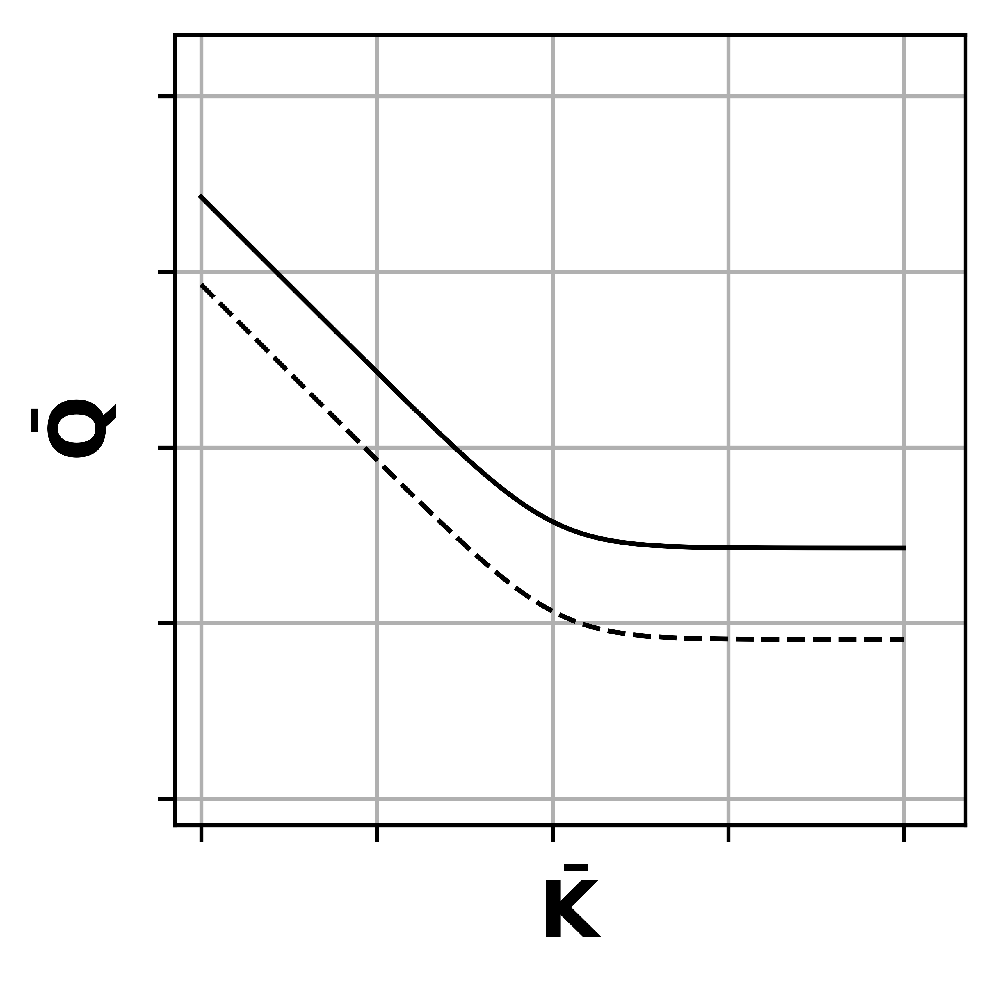

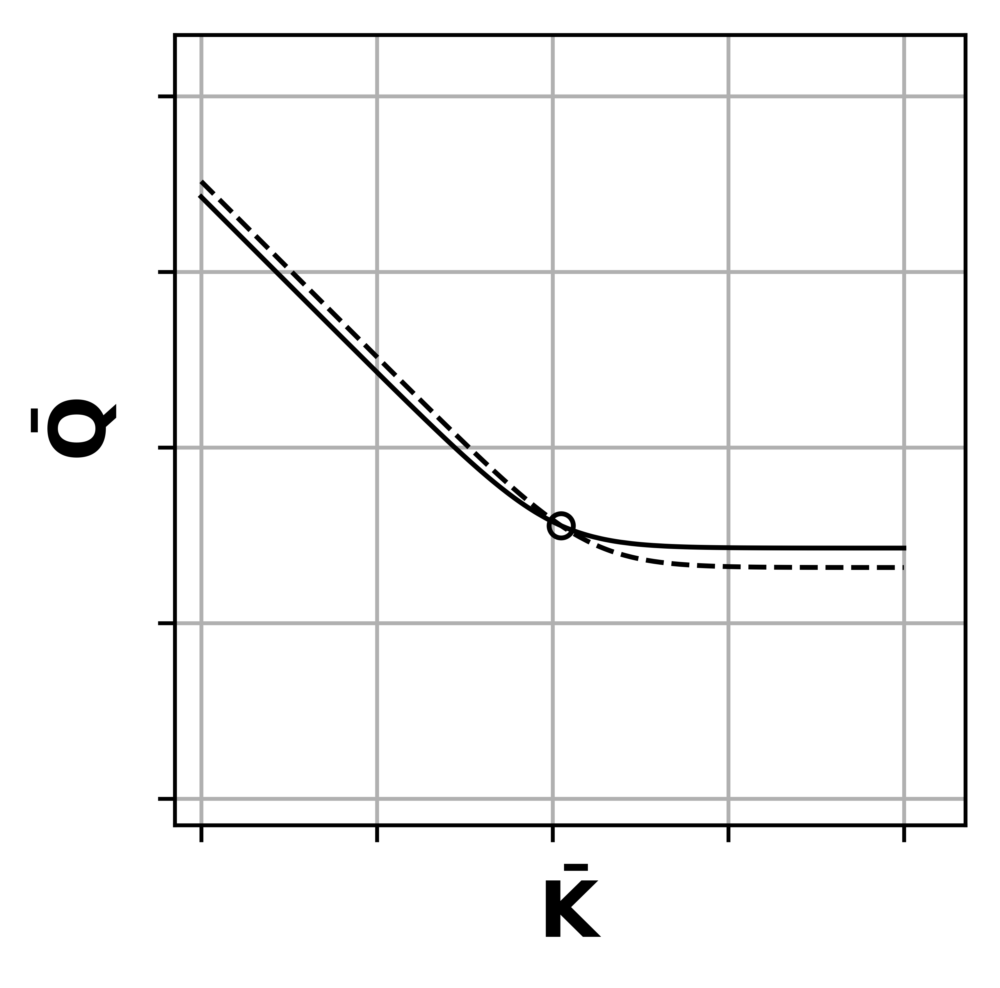

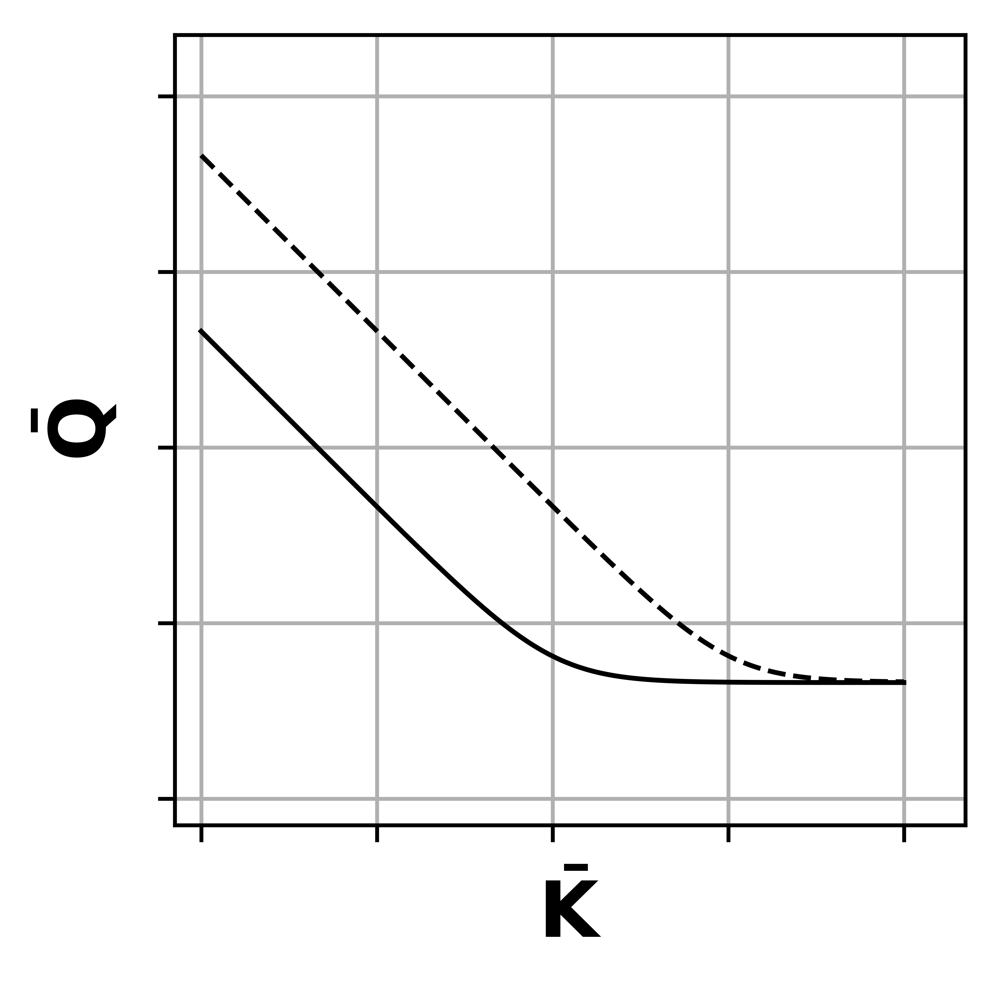

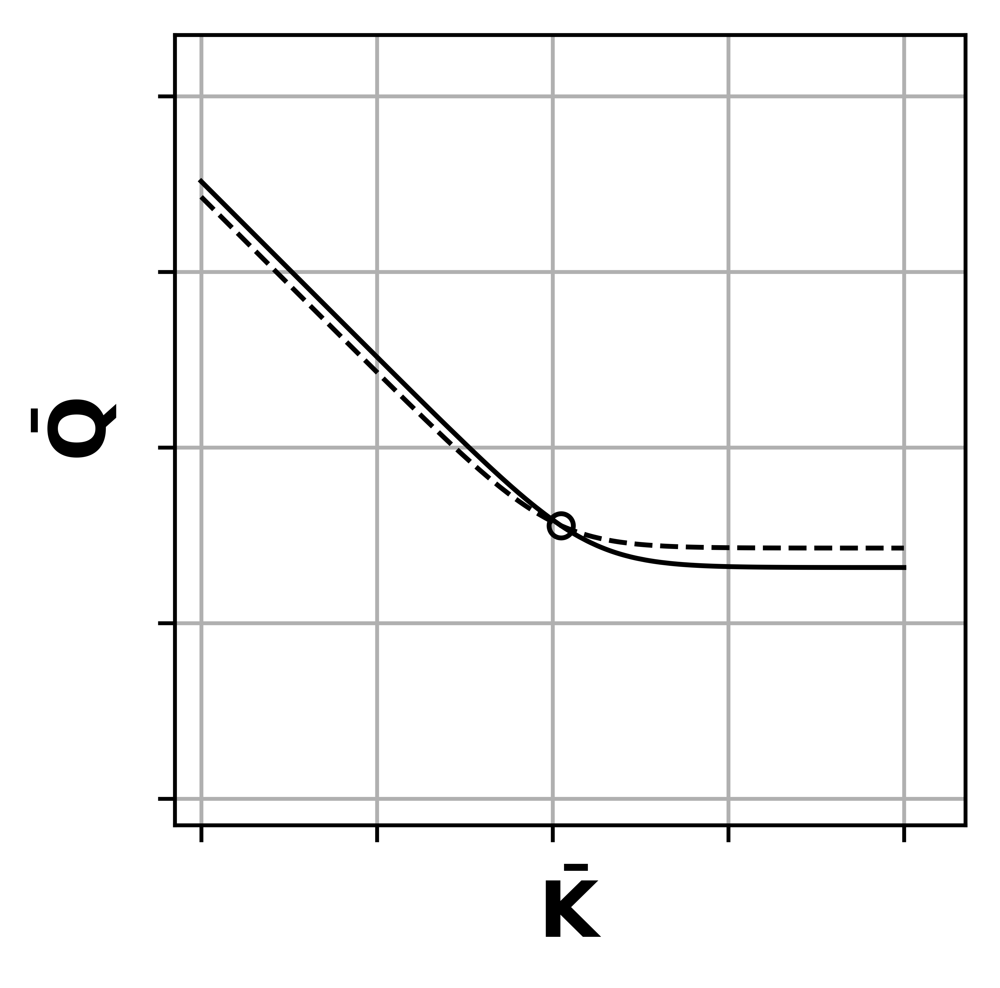

In [17]:
# read data for derivation schematic plots (reusing data from relative behavior figure in the main paper)
N_BV_span_all = np.genfromtxt('case6/N_BV_span_all.csv',delimiter=',');
eps_span = np.genfromtxt('case6/eps_span.csv',delimiter=',');
rec_span = np.genfromtxt('case6/rec_span.csv',delimiter=',');
mpt_Knd = np.genfromtxt('case6/sbmpt_Knondim.csv',delimiter=',');

# loop over parameters and make plots
for i, rec in enumerate(rec_span):
    if not (i == 3):
        N_BV_span = N_BV_span_all[i,:]
        make_deriv_schema(N_BV_span,eps_span[i],rec,mpt_Knd,i)
    elif (i == 3):
        N_BV_span = N_BV_span_all[1,:]
        make_deriv_schema(N_BV_span,eps_span[1],rec_span[1],mpt_Knd,i)
# end loop over eps_span and plot

## Isotherm plots

The data for these plots are obtained by running Case 7 from MATLAB script run_adsorption_analysis.m


### PI-PS-PASH Isotherm

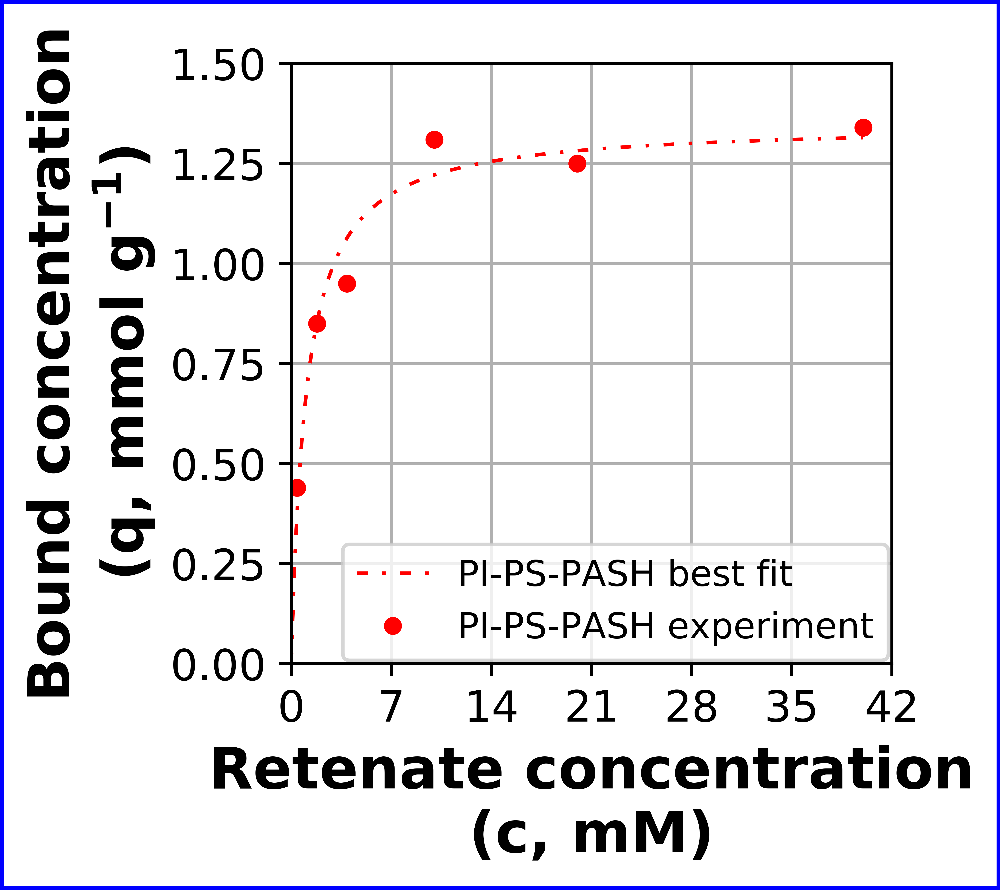

In [18]:
make_isotherm_plots('pash')

### Psf-Terp Isotherm

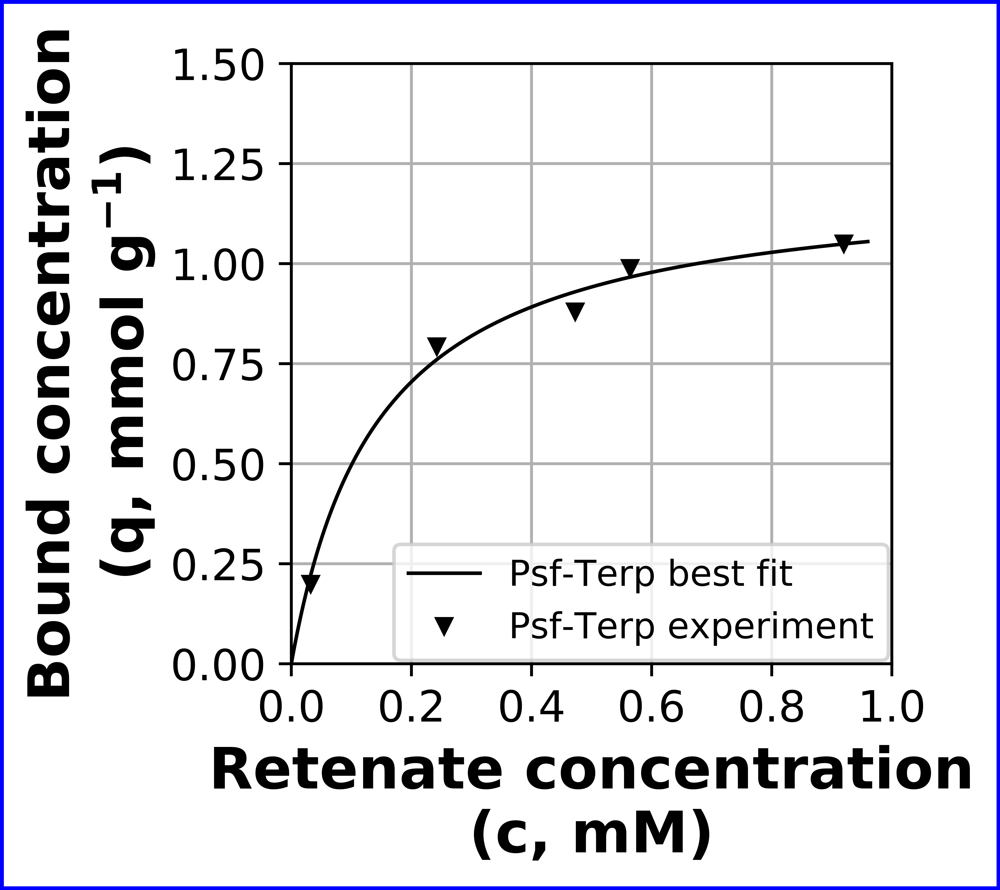

In [19]:
make_isotherm_plots('terp')

## Breakthrough time curves for PI-PS-PASH and Psf-Terp membranes

The data for these plots are obtained by running MATLAB script run_adsorption_analysis.m

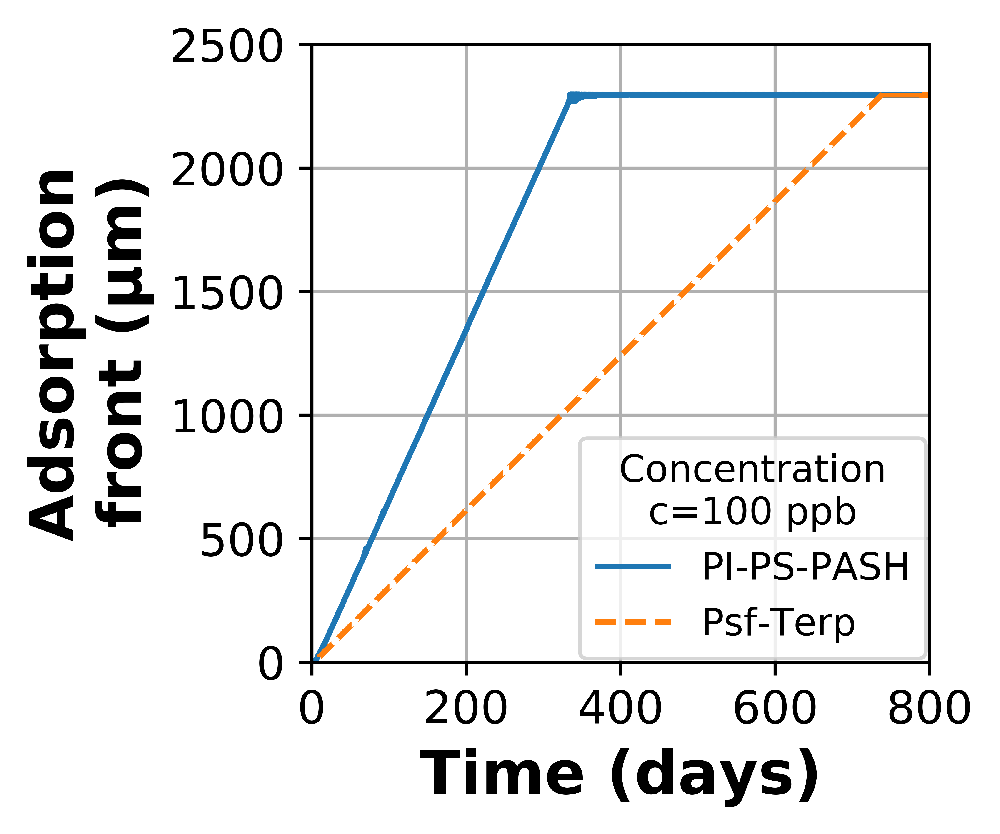

In [20]:
make_breakthrough_curves('case6')

## Batch material property target curves 

### Point of use application 1: Regenerate once in two years

The data for this plot is obtained by running Case 1 from MATLAB script run_adsorption_analysis.m

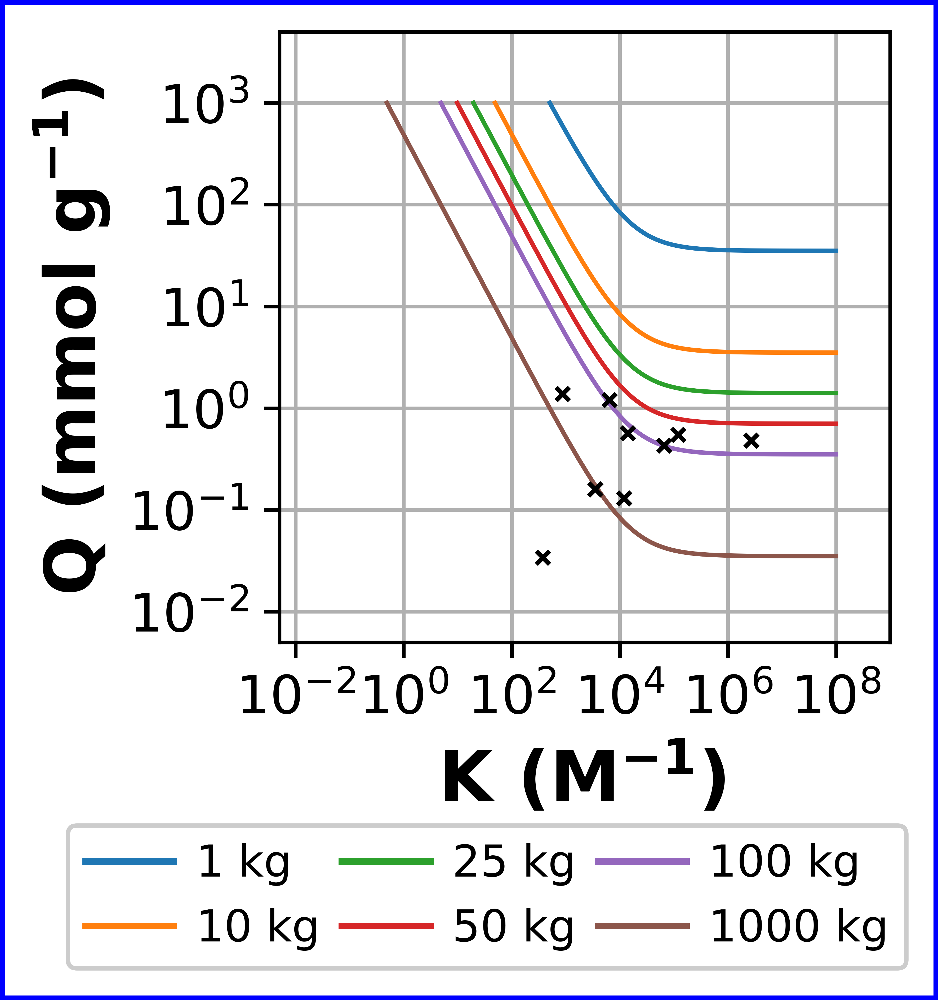

In [21]:
make_batch_material_property_plots('case1')

### Point of use application 2: Regenerate once in six months

The data for this plot is obtained by running Case 2 from MATLAB script run_adsorption_analysis.m

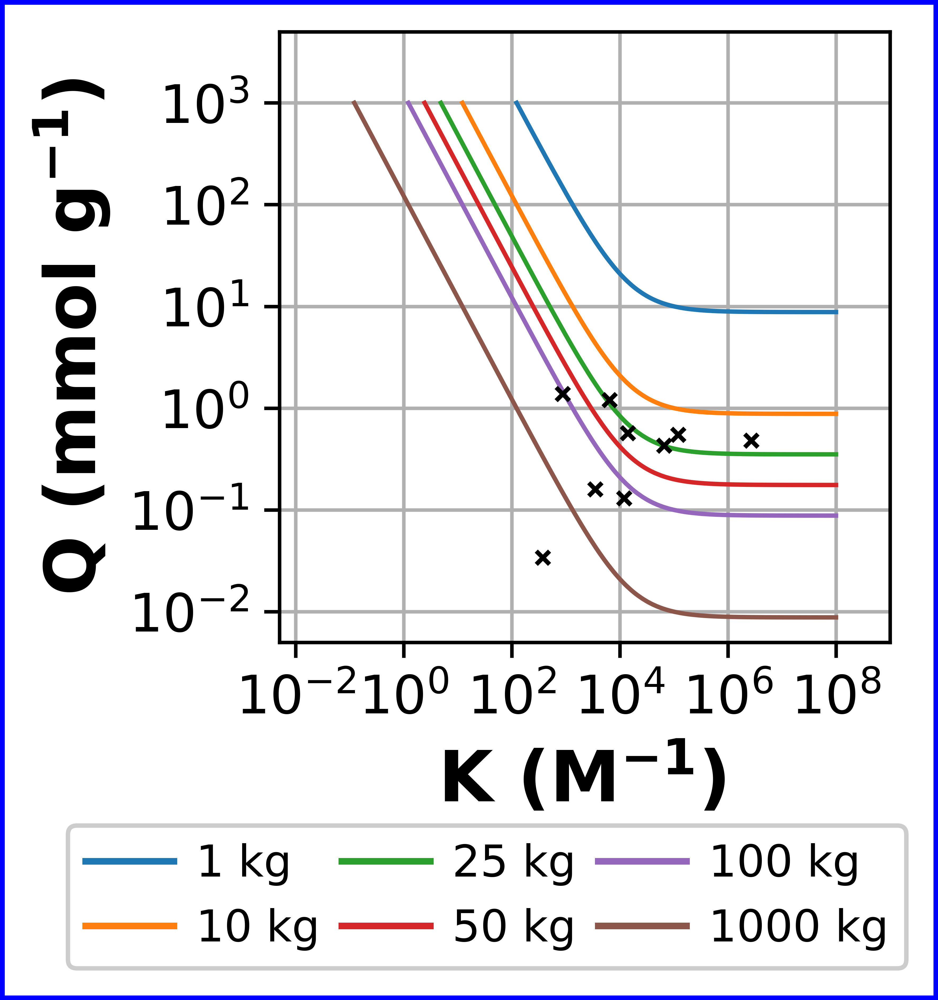

In [22]:
make_batch_material_property_plots('case2')

## Reference dimensionless material property curves

The data for these plots is obtained by running Case 8 in the MATLAB script run_adsorption_analysis.m

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


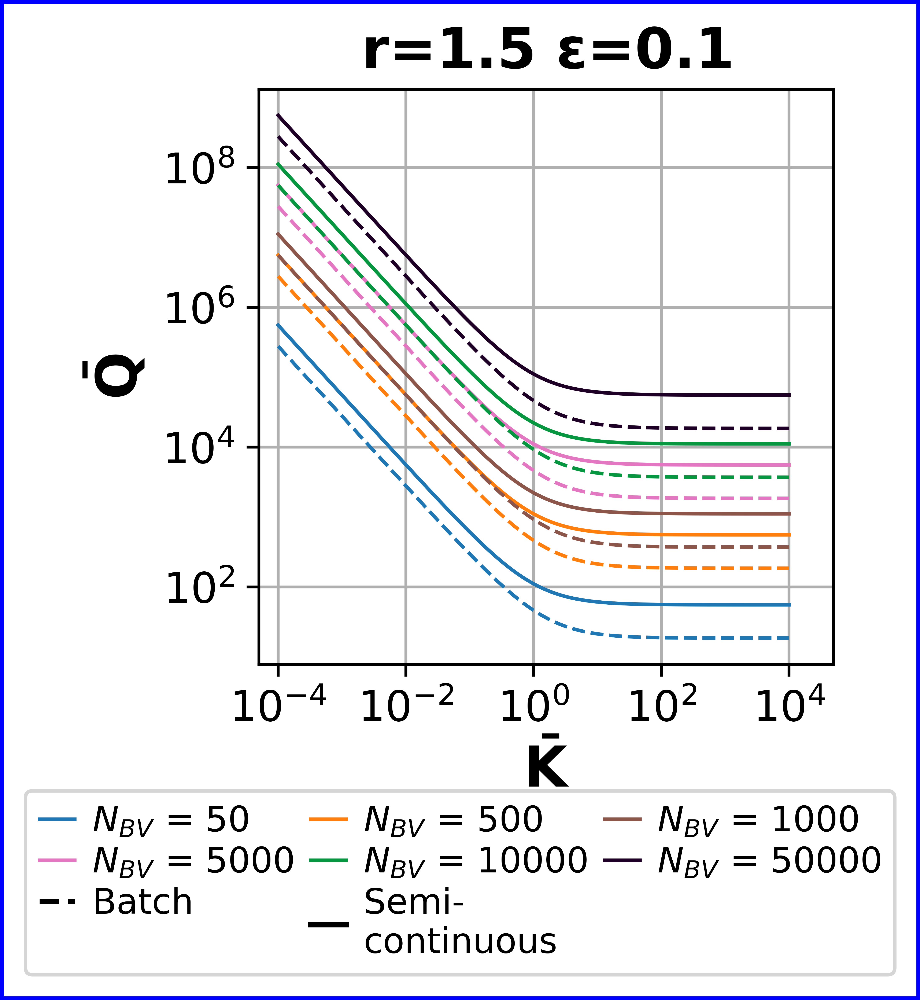

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


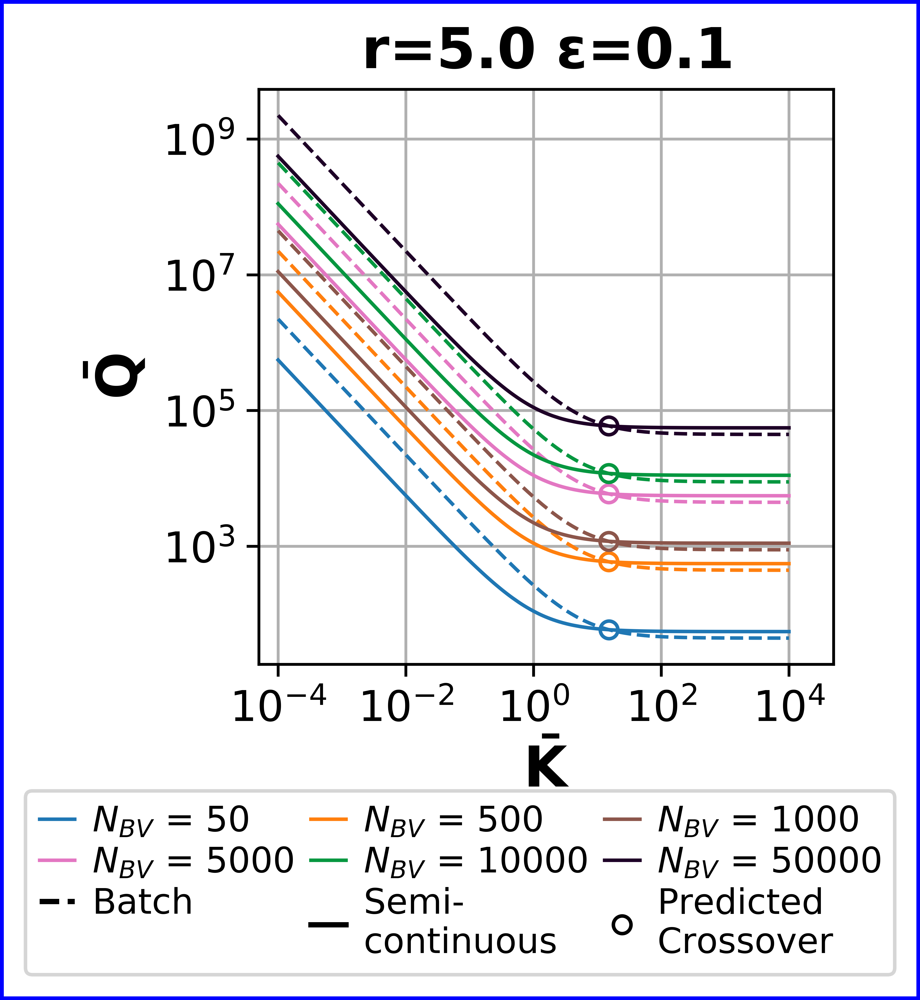

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


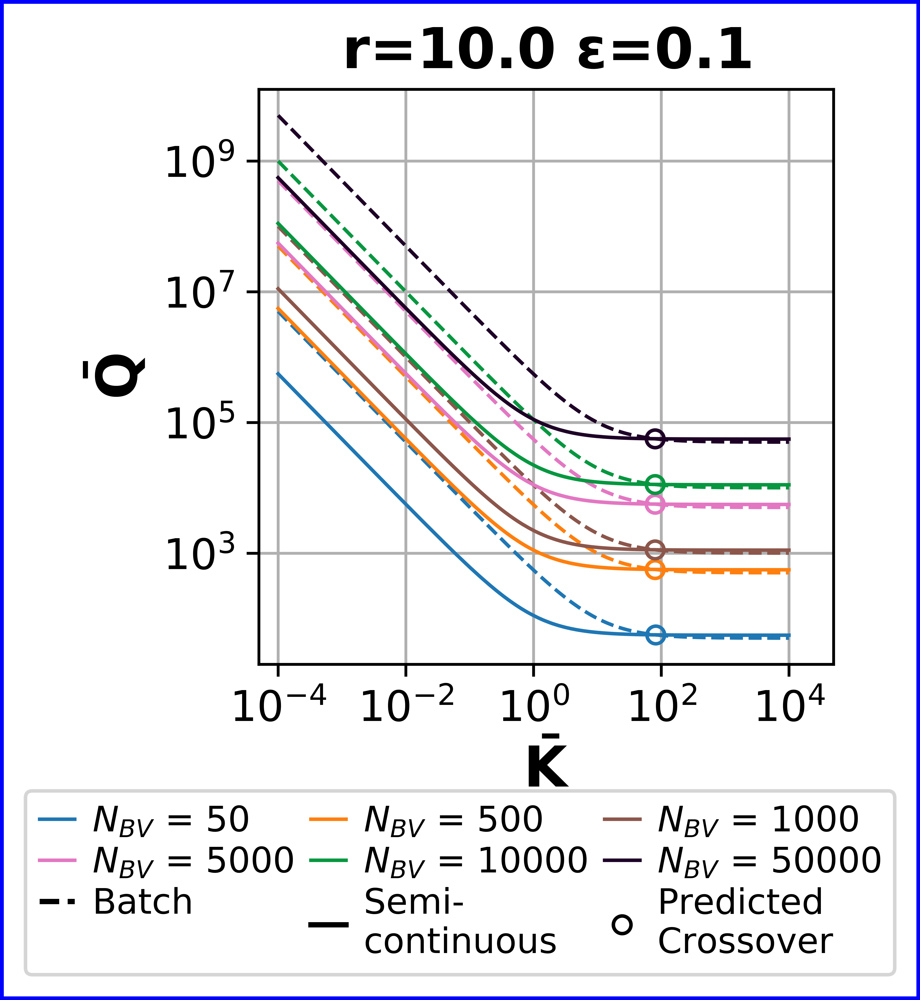

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


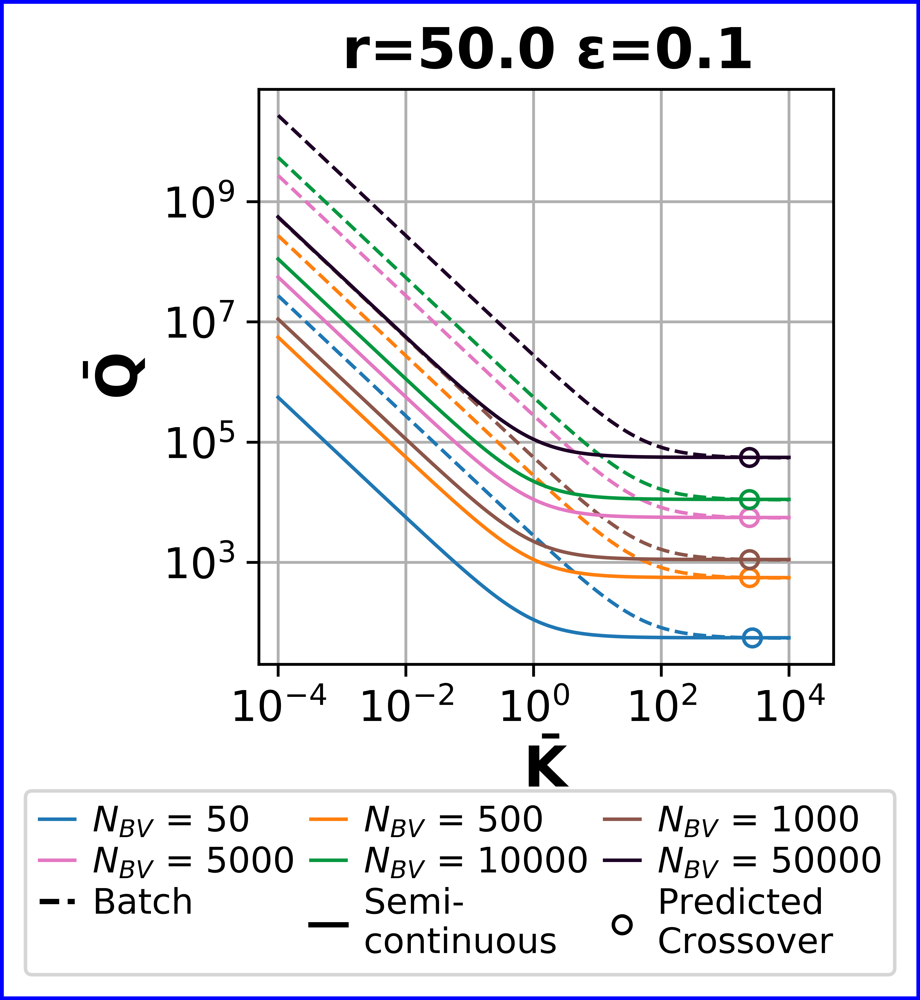

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


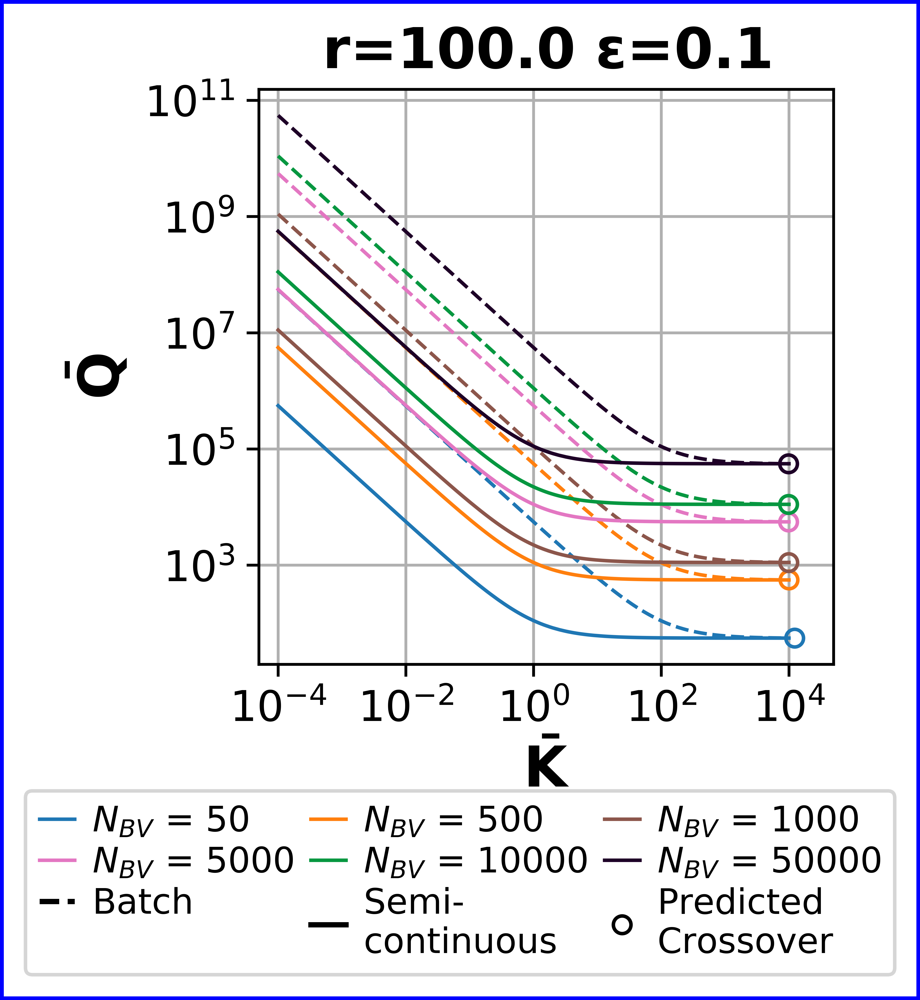

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


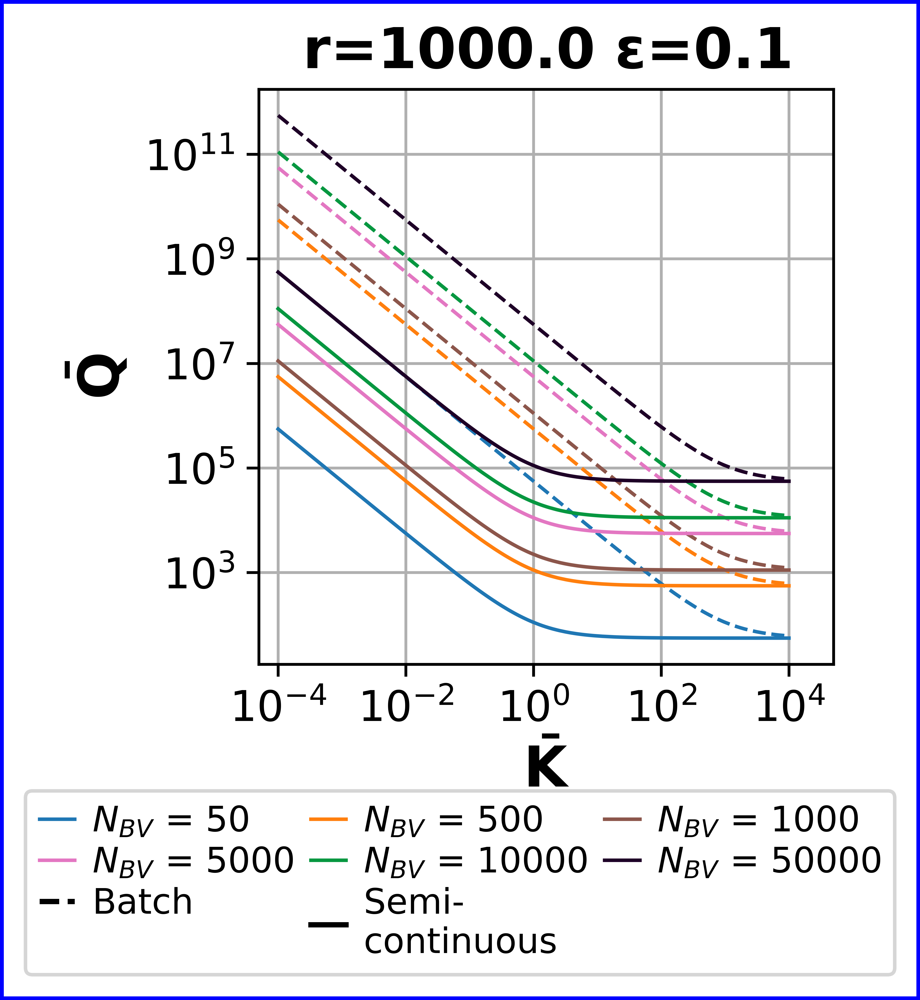

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


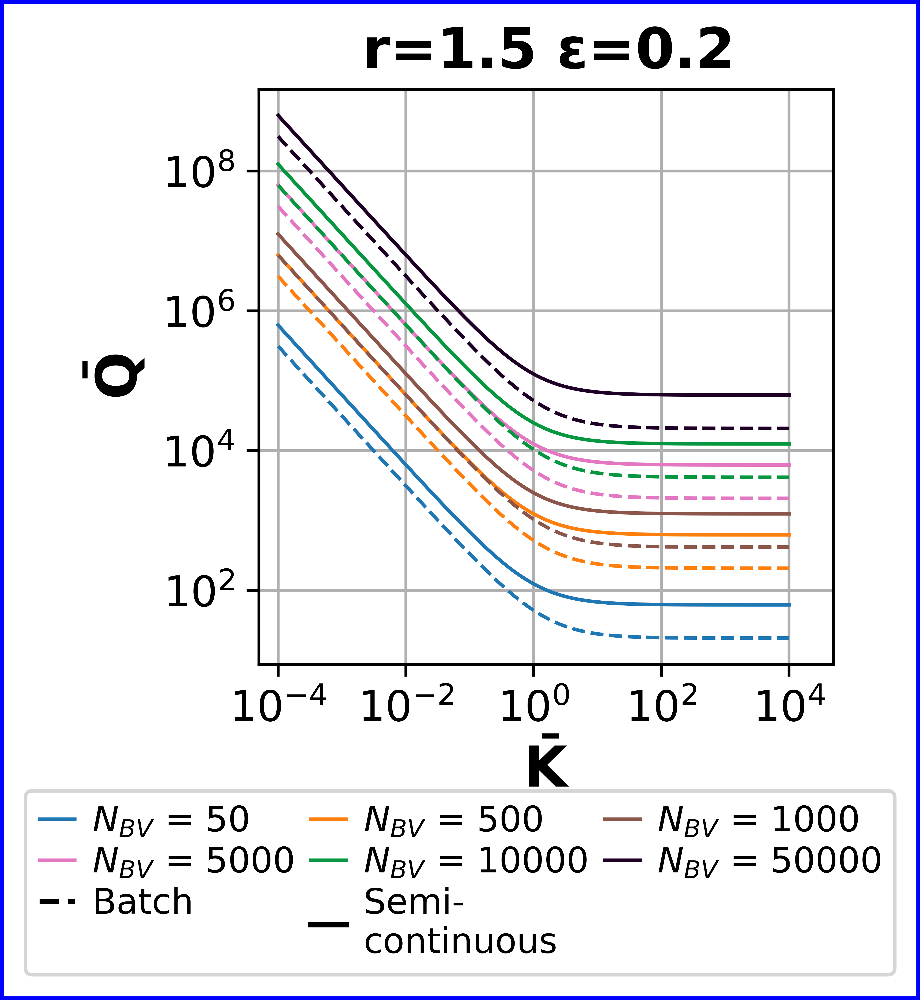

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


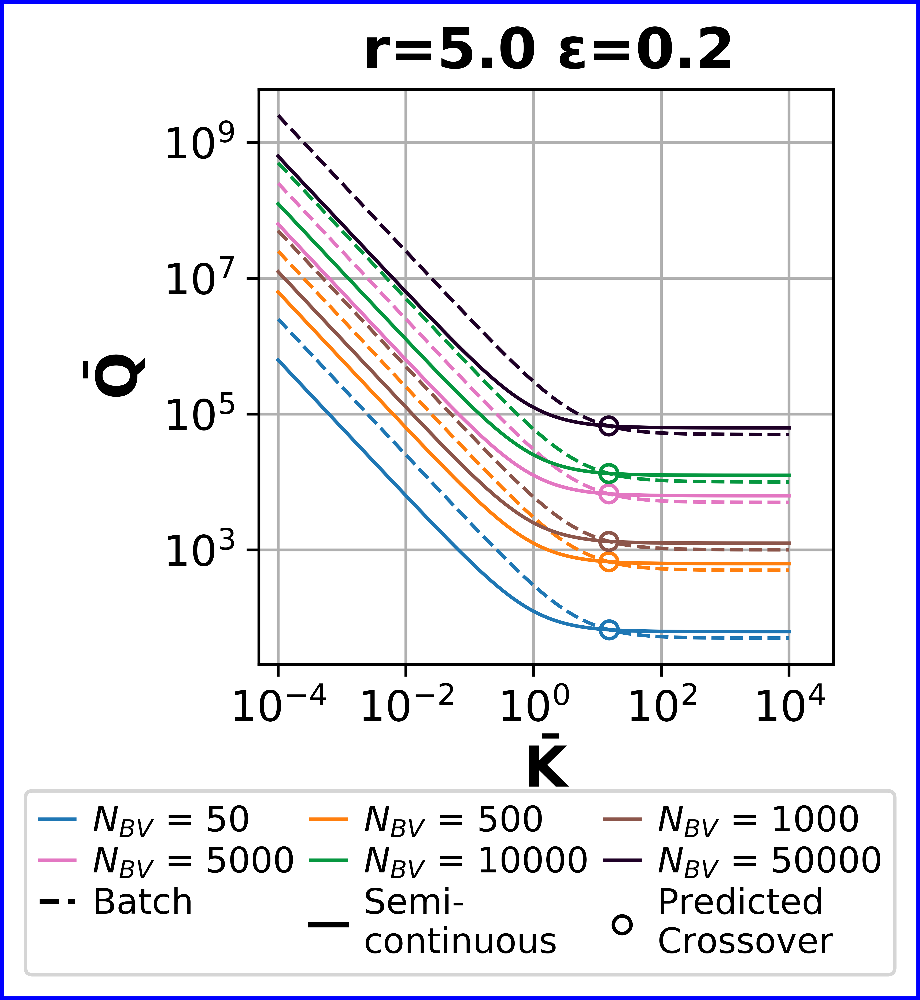

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


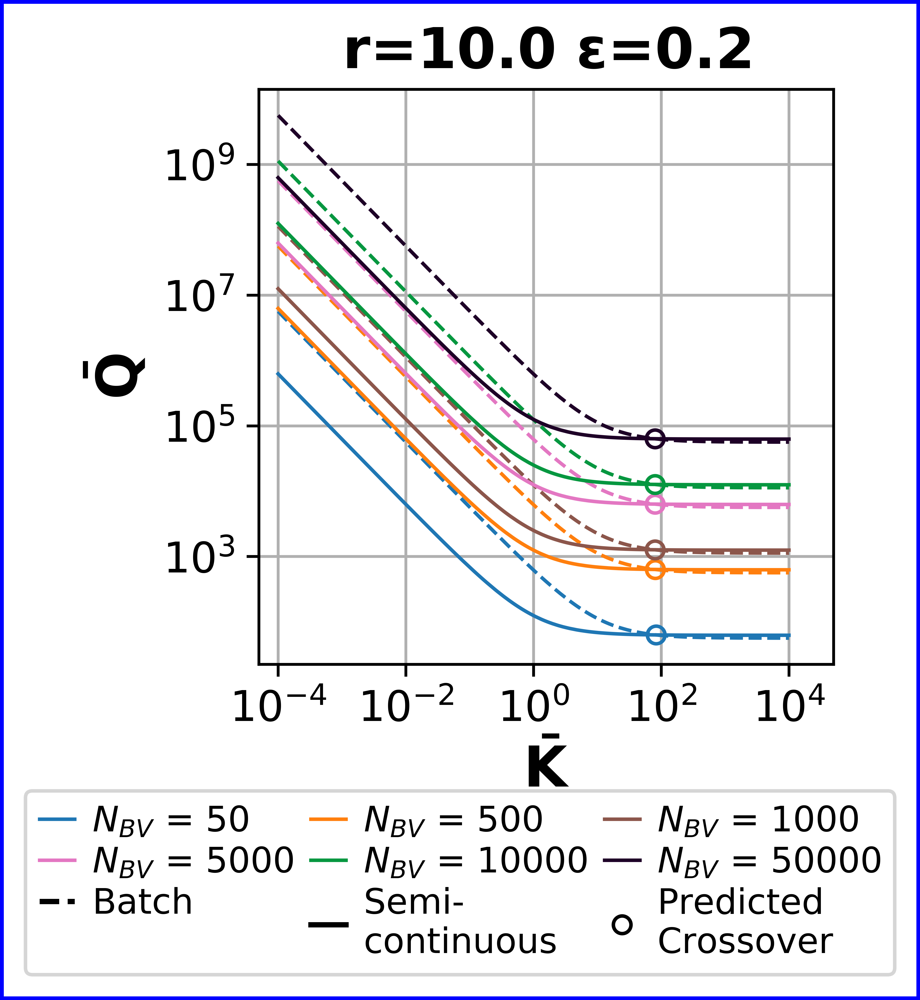

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


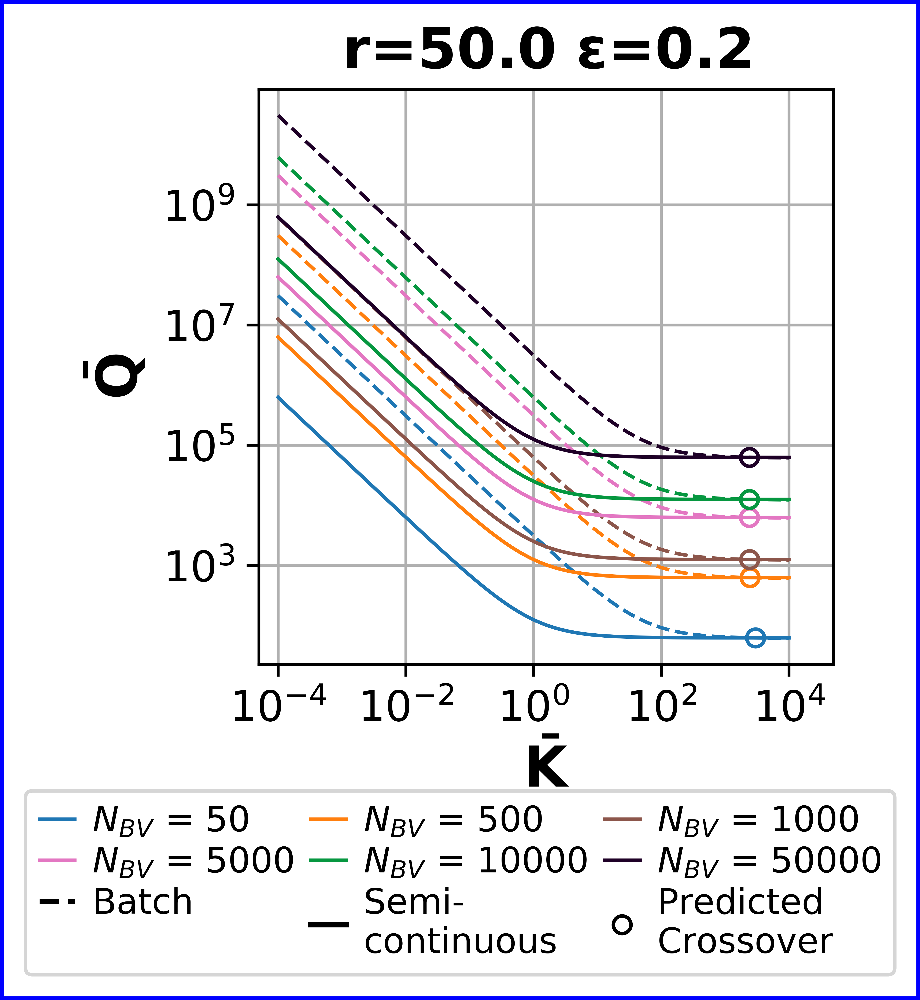

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


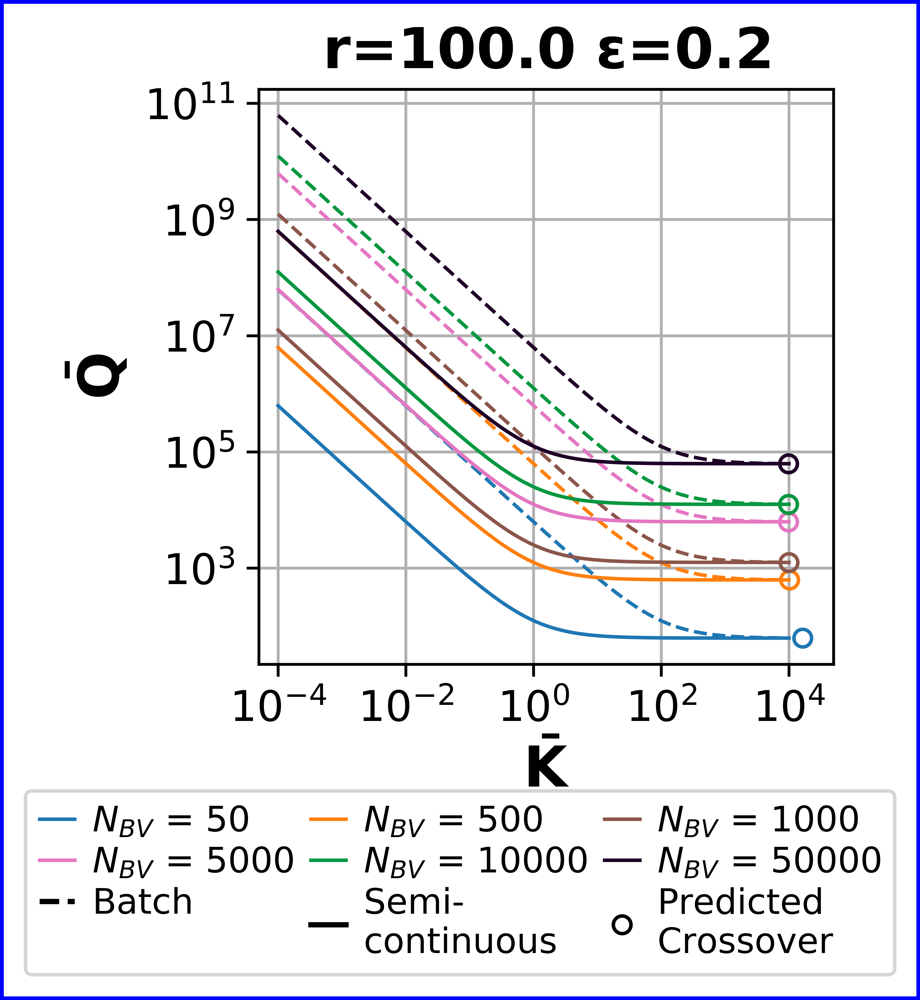

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


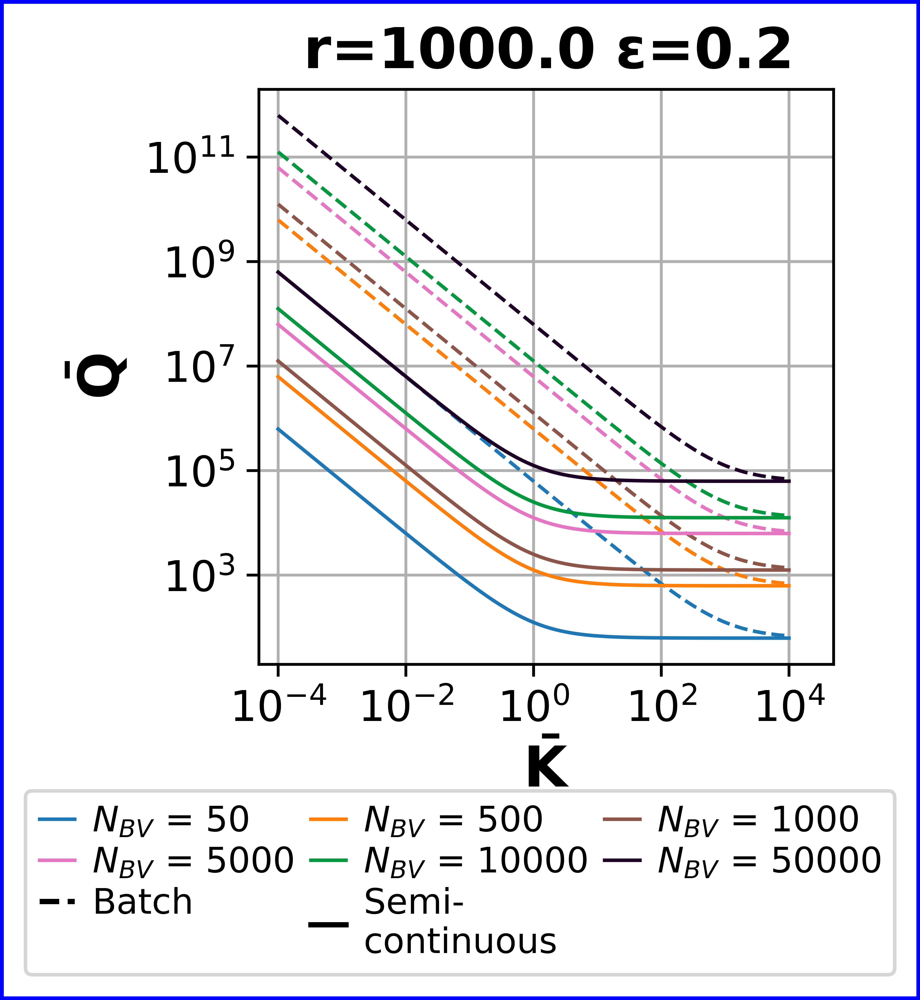

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


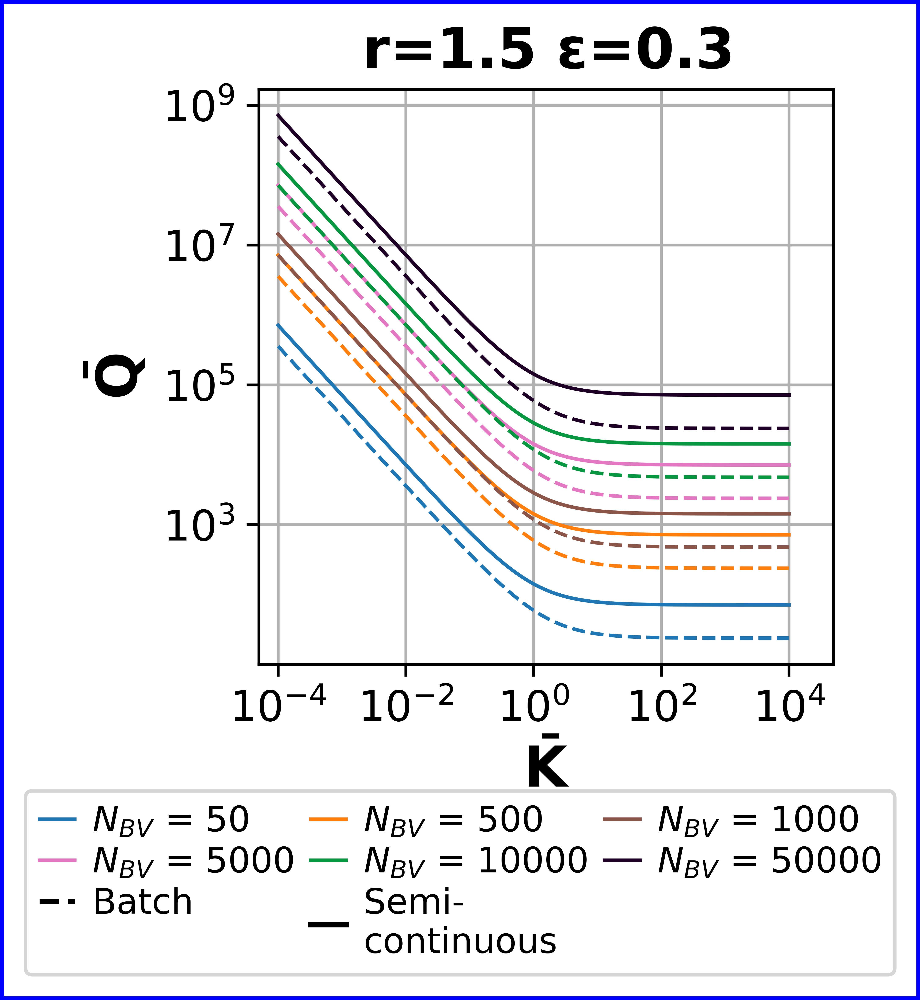

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


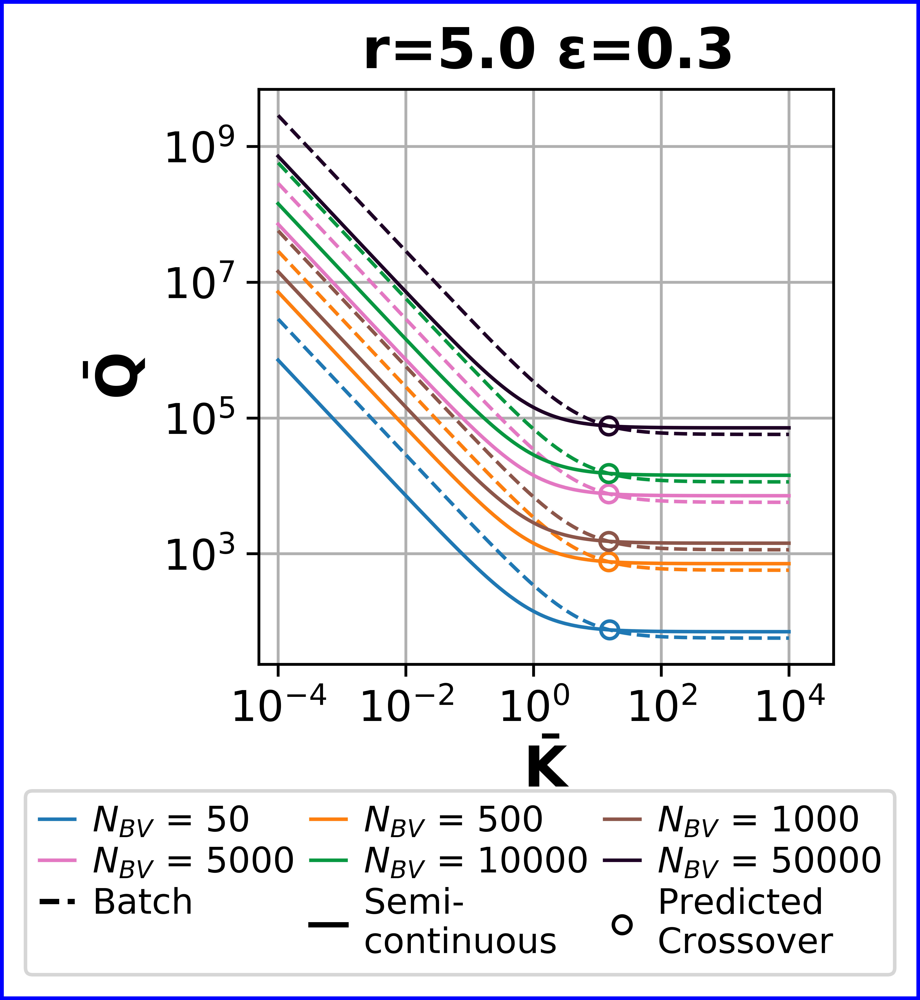

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


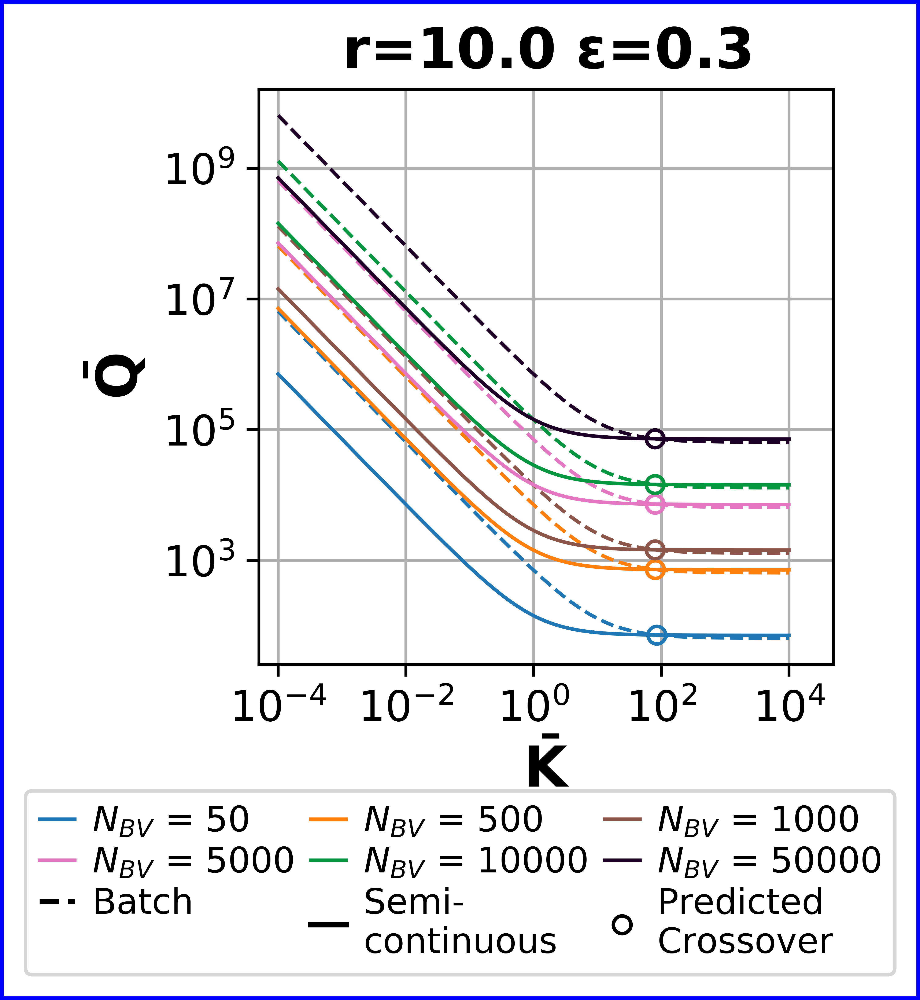

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


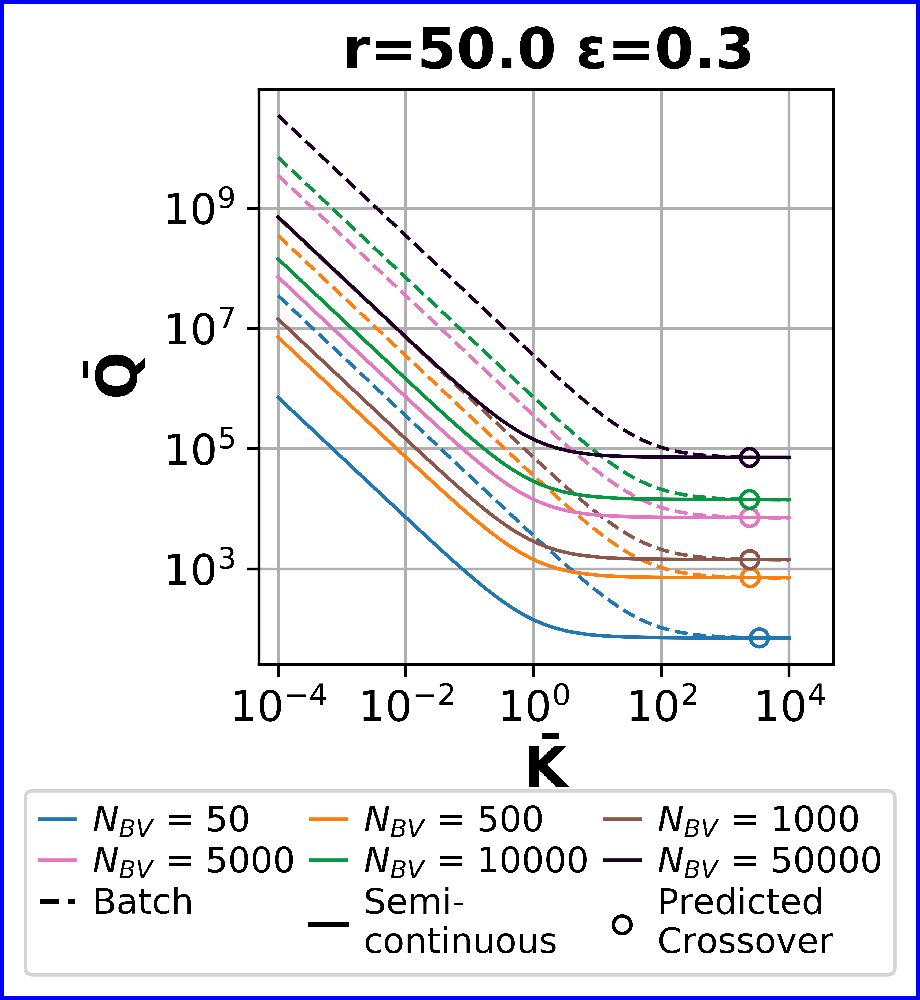

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


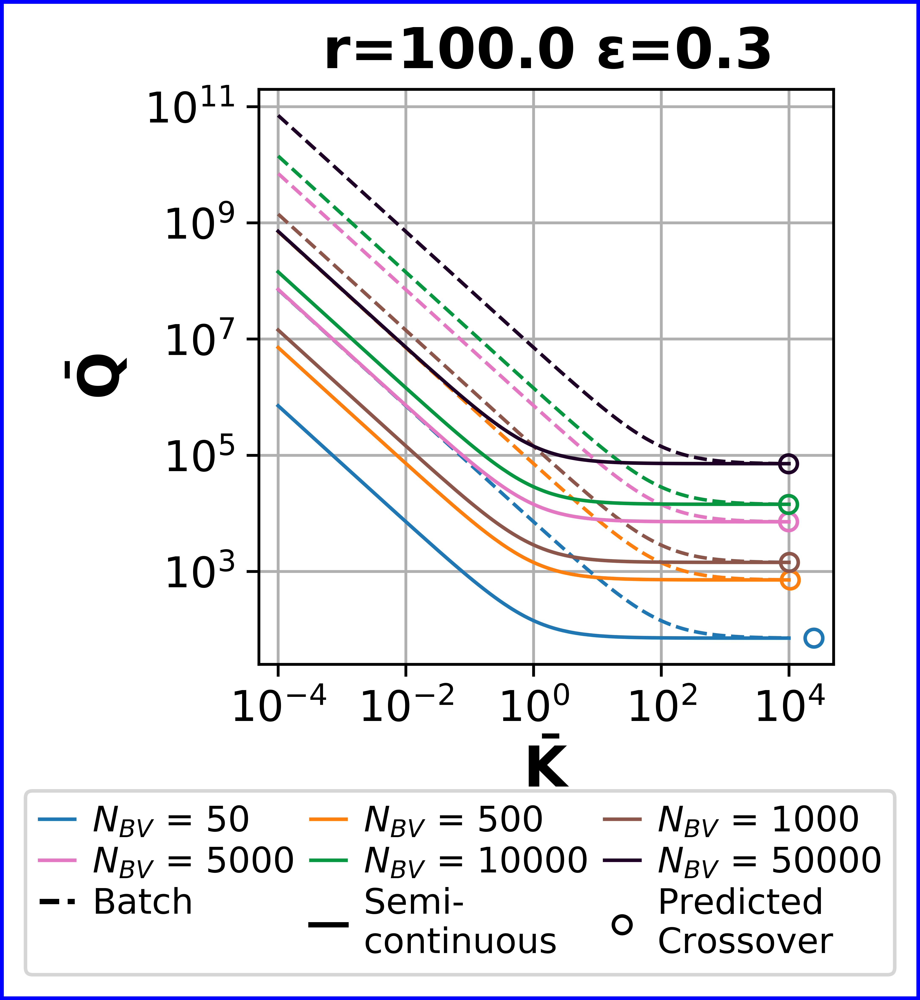

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


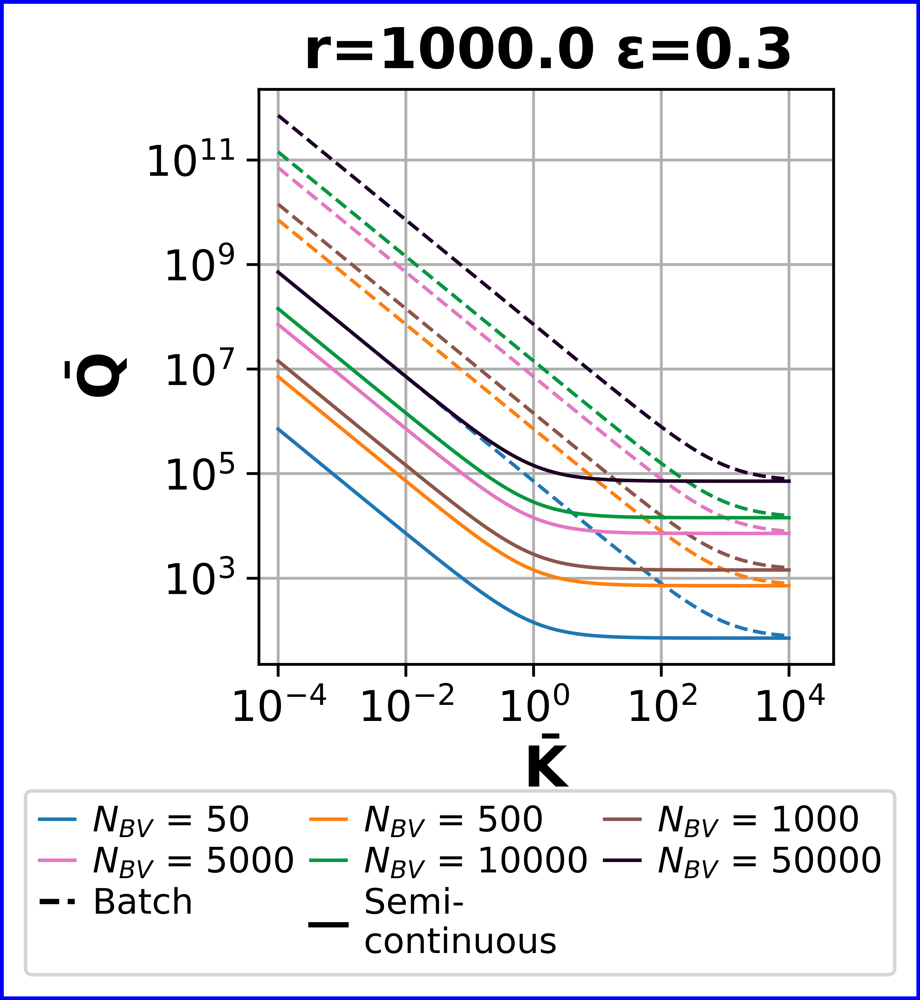

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


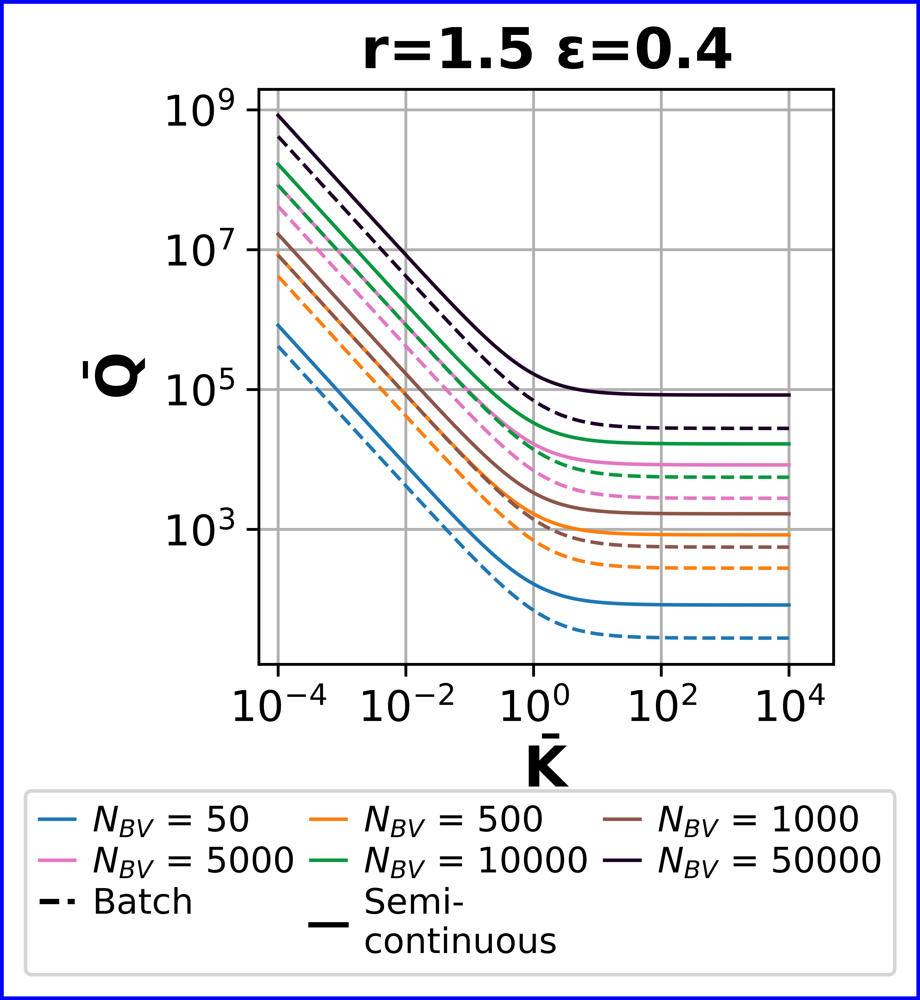

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


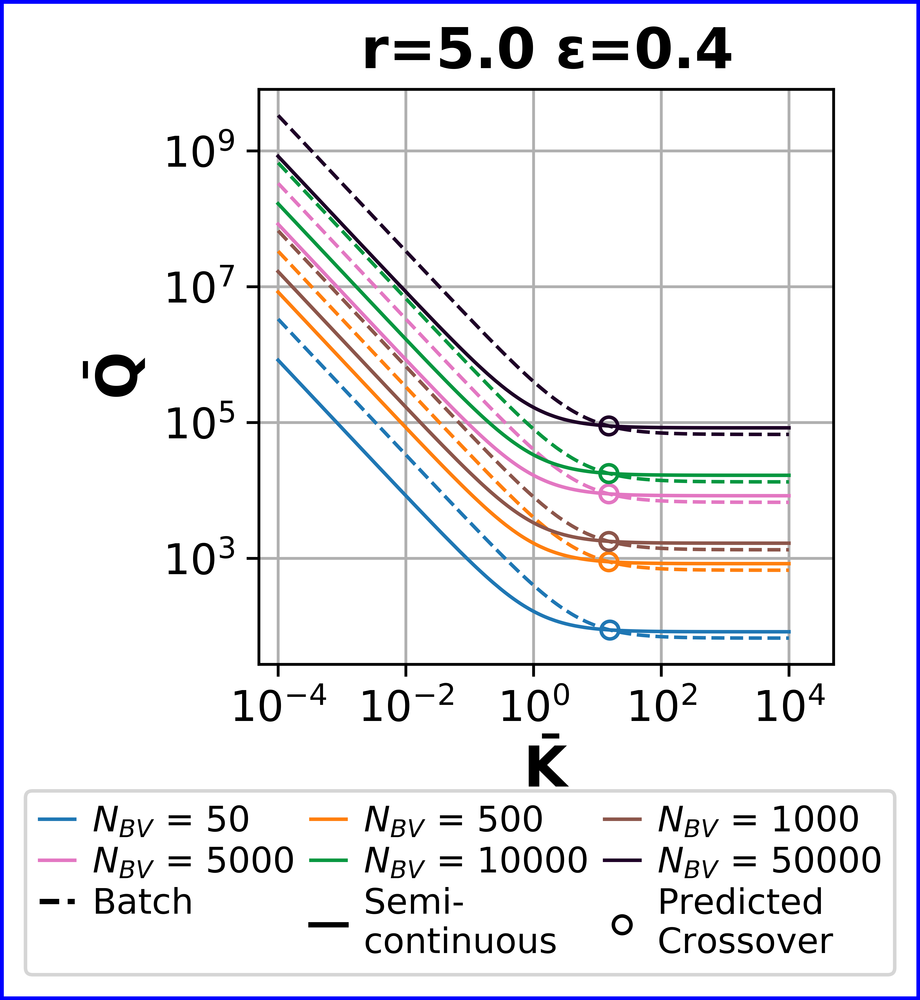

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


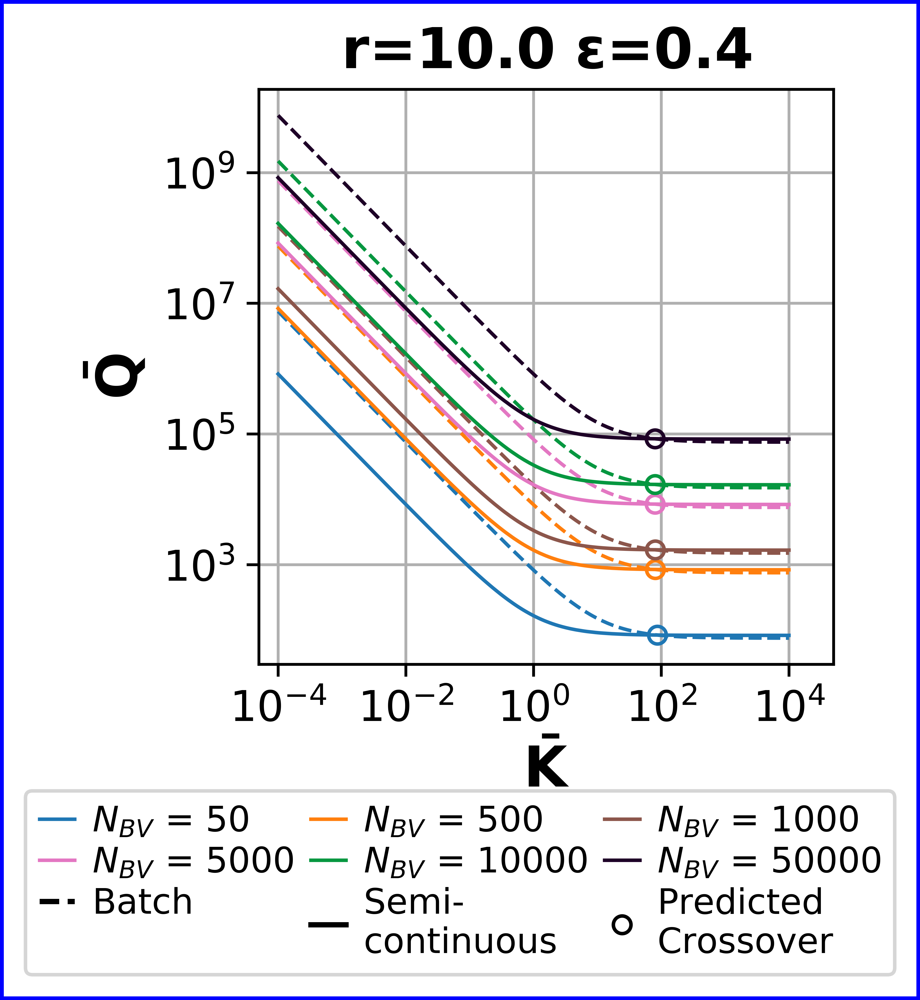

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


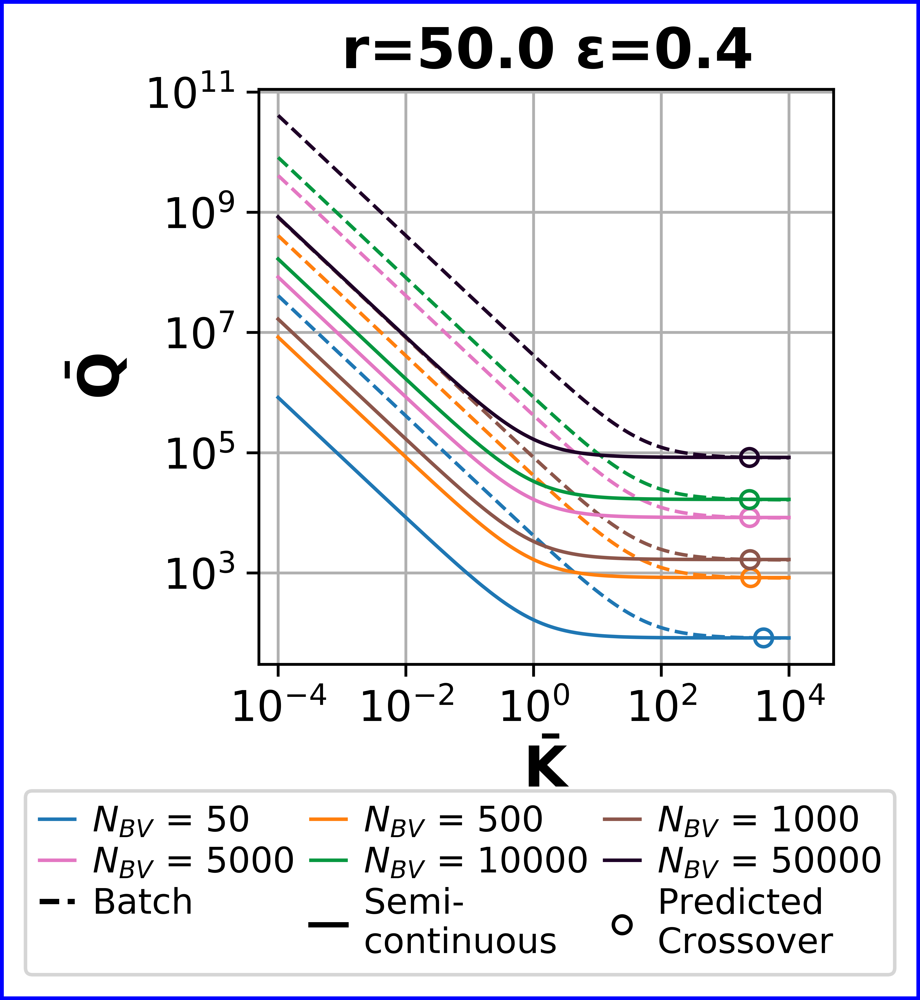

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


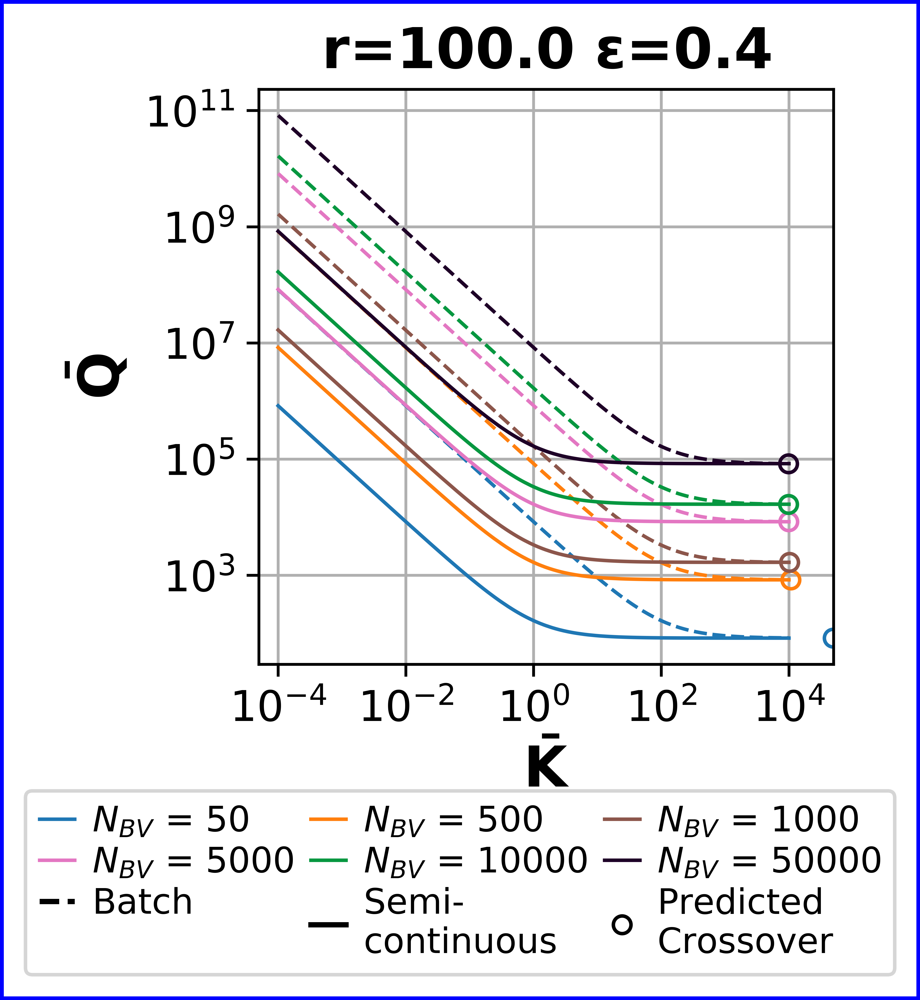

N_BV_span[0]=50.0
N_BV_span[1]=500.0
N_BV_span[2]=1000.0
N_BV_span[3]=5000.0
N_BV_span[4]=10000.0
N_BV_span[5]=50000.0


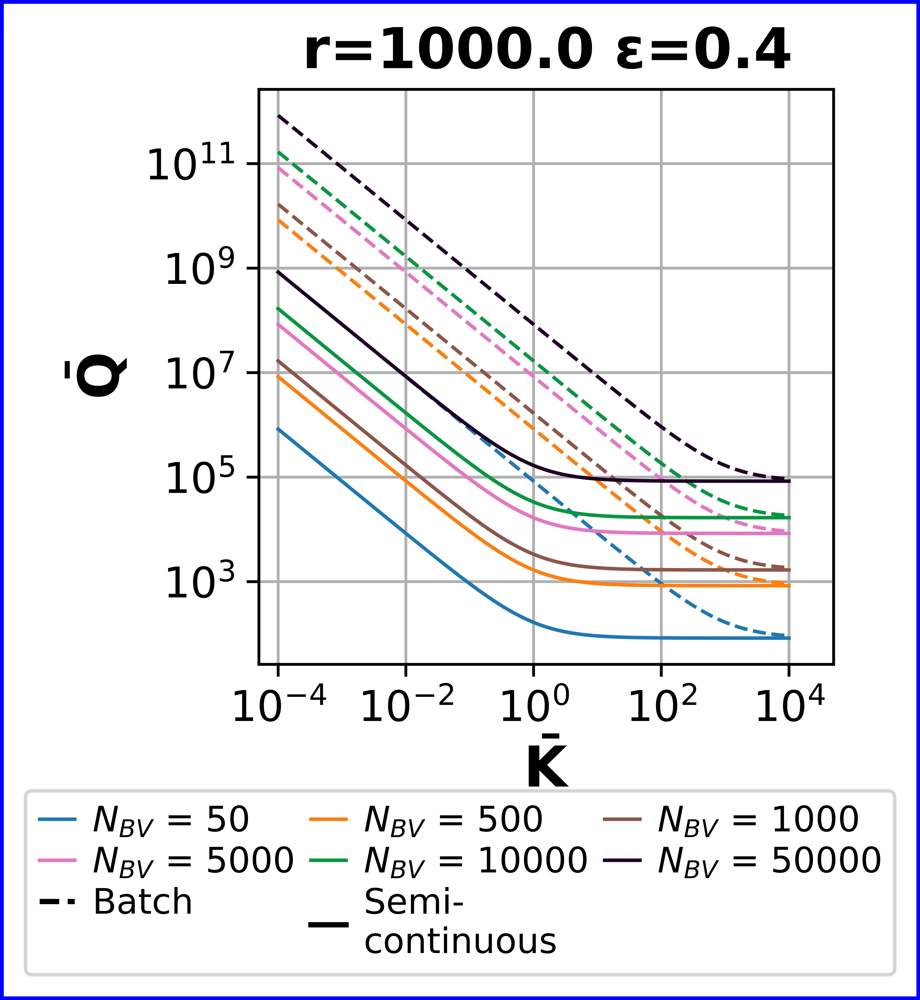

In [23]:
N_BV_span_all = np.genfromtxt('case8/N_BV_span_all.csv',delimiter=',');
eps_span = np.genfromtxt('case8/eps_span.csv',delimiter=',');
rec_span = np.genfromtxt('case8/rec_span.csv',delimiter=',');
mpt_Knd = np.genfromtxt('case8/sbmpt_Knondim.csv',delimiter=',');

# loop over parameters and make plots
for i, rec in enumerate(rec_span):  
    N_BV_span = N_BV_span_all[i,:]
    make_supporting_ndmpt_plots(N_BV_span,eps_span[i],rec,mpt_Knd)
# end loop over eps_span